# <Center> Analysis and forecasting of Electricity Information Administration Electricity Demand Data </Center>

# <center> Exploratory Data Analysis of EIA Data </center>

## Section 1: Analysis of Electric Power Operational Data

### Load essential libraries

In [2]:
import eia
from collections import defaultdict
import pandas as pd
import plotly.express as px
import numpy as np
import chart_studio.plotly as py
import plotly.offline as po
import plotly.graph_objs as pg
import warnings
warnings.filterwarnings("ignore")

### Load electric power operational data

In [3]:
df = eia.loaders.load_dataframe(data="electric-power-operational-data")

/Users/nehamittal/data/eia-py/data/csv/electric-power-operational-data_data.csv


### Filter data for "All Sectors"

In [4]:
df_all_sectors = df.loc[df["sectorDescription"] == "All Sectors", :]

In [5]:
len(df_all_sectors)

719

### List top n fuels by the amount of energy consumption

In [6]:
top_n_fuels = ['natural gas', 'all coal products', 'renewable', 'nuclear']

In [7]:
df_all_sectors_f = df_all_sectors.query("fuelTypeDescription in @top_n_fuels")

### Create a dataframe of relevant metrics

In [8]:
df_all_sectors_r = df_all_sectors_f[['period', 'location', 'stateDescription','fueltypeid', 'fuelTypeDescription', 'total-consumption-btu', 'consumption-for-eg-btu','consumption-uto-btu']].dropna()

### Take the aggreagate of fuel type units across period

In [9]:
consumption_by_source_data = pd.DataFrame(df_all_sectors_r.groupby(["period", "fuelTypeDescription"]).sum())

In [10]:
consumption_by_source_data = consumption_by_source_data.reset_index()

### Data for some fuel types is not present for April 2022 hence remove them from our analysis

In [11]:
consumption_by_source_data= consumption_by_source_data[consumption_by_source_data["period"]!='2022-04']

In [12]:
consumption_by_source_data.head()

,period,fuelTypeDescription,total-consumption-btu,consumption-for-eg-btu,consumption-uto-btu
0,2021-07,natural gas,110.13580,102.65174,7.48405
1,2021-07,nuclear,87.46323,87.46323,0.00000
2,2021-07,renewable,104.37803,85.10713,19.27090
3,2021-08,renewable,1.82152,1.81353,0.00800
4,2021-09,all coal products,116.80159,115.67027,1.13132


### Plot energy consumption by top n fuels across periods

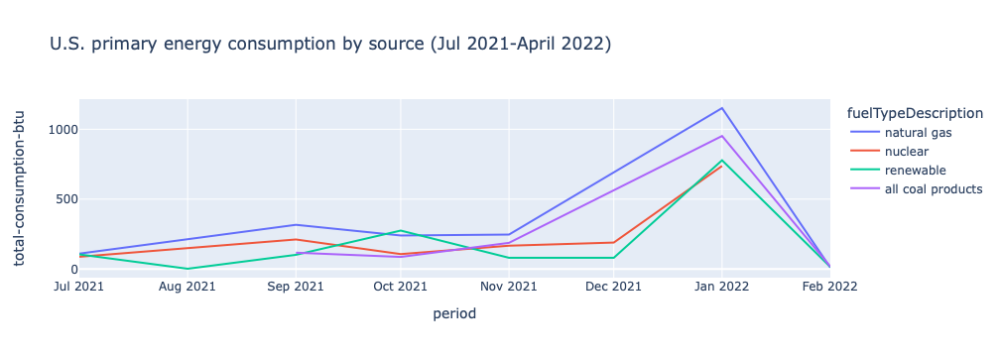

In [13]:
fig = px.line(consumption_by_source_data, x="period", y="total-consumption-btu", color='fuelTypeDescription', title='U.S. primary energy consumption by source (Jul 2021-April 2022)')
fig.show()

In [14]:
fig.write_html("energy_consumption_by_source.html")

### Load US population and deaths due to cancer data set

In [3]:
pop_df = pd.read_csv("US_population.csv")

### Add death and population data to our electric power operational dataframe

In [4]:
df['population'] = 0
df['Cancer_deaths'] = 0

In [5]:
for j in range(len(pop_df)):
    for i in range(len(df)):
        if df.loc[i,"stateDescription"] == pop_df.loc[j,"States"]:
            df.loc[i, "population"] = int(pop_df.loc[j,"Annual Residential Population"].replace(',',''))
            df.loc[i, "Cancer_deaths"] = pop_df.loc[j,"Cancer Deaths"]

In [6]:
df2 = df.loc[df["sectorDescription"] == "Electric Power", :]

In [9]:
df2.head()

,Unnamed: 0,period,location,stateDescription,sectorid,sectorDescription,fueltypeid,fuelTypeDescription,generation,generation-units,...,cost-per-btu,cost-per-btu-units,sulfur-content,sulfur-content-units,ash-content,ash-content-units,heat-content,heat-content-units,population,Cancer_deaths
0,0,2021-06,SD,South Dakota,98,Electric Power,AOR,all renewables,660.11939,thousand megawatthours,...,NaN,dollars per million Btu,0.00,percent,0.0,percent,0.000,Btu per physical units,895376,376
1,1,2021-06,SD,South Dakota,98,Electric Power,BIO,biomass,0.00000,thousand megawatthours,...,NaN,dollars per million Btu,0.00,percent,0.0,percent,0.000,Btu per physical units,895376,376
2,2,2021-06,SD,South Dakota,98,Electric Power,COL,"coal, excluding waste coal",205.22798,thousand megawatthours,...,NaN,dollars per million Btu,0.84,percent,5.2,percent,16.402,Btu per short tons,895376,376
3,3,2021-06,SD,South Dakota,98,Electric Power,COW,all coal products,205.22798,thousand megawatthours,...,1.825,dollars per million Btu,0.84,percent,5.2,percent,16.402,Btu per short tons,895376,376
4,4,2021-06,SD,South Dakota,98,Electric Power,DFO,distillate fuel oil,NaN,thousand megawatthours,...,NaN,dollars per million Btu,0.00,percent,0.0,percent,6.000,Btu per short tons,895376,376


### Generate ash content dataframe

In [10]:
ash_content = pd.DataFrame(df2[["stateDescription", "location", "ash-content", "generation", "population", "Cancer_deaths"]].groupby(["stateDescription", "location", "population", "Cancer_deaths"]).sum())

In [11]:
ash_content = ash_content.reset_index()

### Plot ash content% across US states

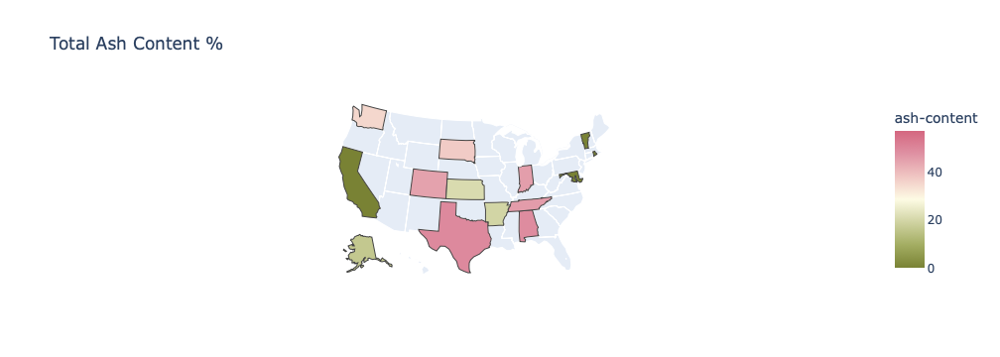

In [12]:
try:
    fig = px.choropleth(ash_content, 
                        locations = 'location',
                        locationmode = 'USA-states',
                        scope = 'usa',
                        color = 'ash-content',
                        hover_name = 'location',
                        hover_data = ['stateDescription', 'ash-content'],
                        range_color = [0,ash_content["ash-content"].max()],
                        color_continuous_scale = 'armyrose',
                        title = 'Total Ash Content %')
    fig.show()
except:
    pass

In [13]:
fig.write_html("total_ash_content.html")

### Plot ash content per electric power generation across US states

In [14]:
ash_content["ash_per_gen"] = ash_content["ash-content"]/ash_content["generation"]

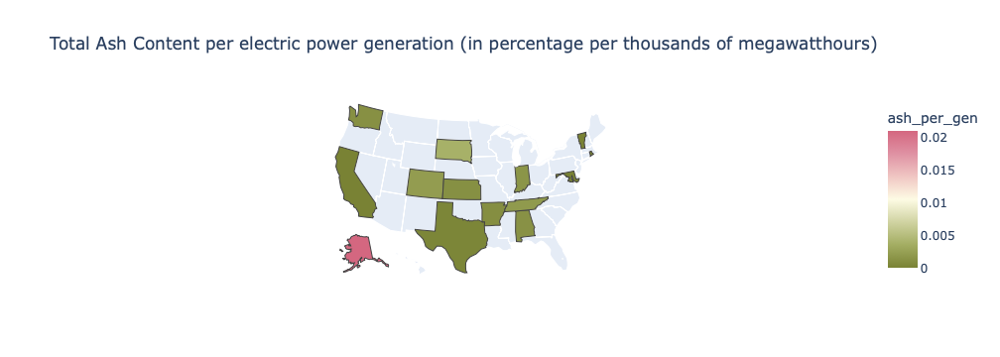

In [15]:
try:
    fig = px.choropleth(ash_content, 
                        locations = 'location',
                        locationmode = 'USA-states',
                        scope = 'usa',
                        color = 'ash_per_gen',
                        hover_name = 'location',
                        hover_data = ['stateDescription','ash_per_gen', 'ash-content'],
                        range_color = [0,ash_content["ash_per_gen"].max()],
                        color_continuous_scale = 'armyrose',
                        title = 'Total Ash Content per electric power generation (in percentage per thousands of megawatthours)')
    fig.show()
except:
    pass

In [16]:
fig.write_html("total_ash_content_per_electric_power_generation.html")

### Plot ash content per capita across US states

In [17]:
ash_content["ash_per_capita"] = ash_content["ash-content"]/ash_content["population"]

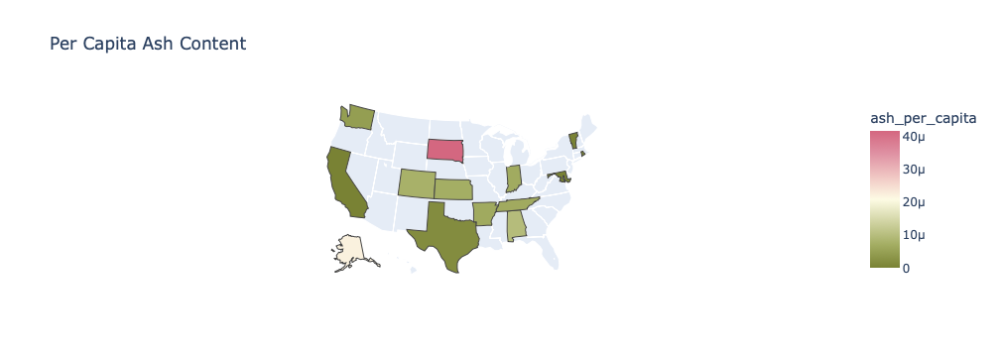

In [18]:
try:
    fig = px.choropleth(ash_content, 
                        locations = 'location',
                        locationmode = 'USA-states',
                        scope = 'usa',
                        color = 'ash_per_capita',
                        hover_name = 'location',
                        hover_data = ['stateDescription','ash_per_capita', 'ash-content'],
                        range_color = [0,ash_content["ash_per_capita"].max()],
                        color_continuous_scale = 'armyrose',
                        title = 'Per Capita Ash Content')
    fig.show()
except:
    pass

In [19]:
fig.write_html("total_ash_content_per_capita.html")

### Generate heat content dataframe

In [20]:
heat_content = pd.DataFrame(df2[["stateDescription", "location", "heat-content", "generation", "population"]].groupby(["stateDescription", "location", "population"]).sum())

In [21]:
heat_content = heat_content.reset_index()

### Plot heat content% across US states

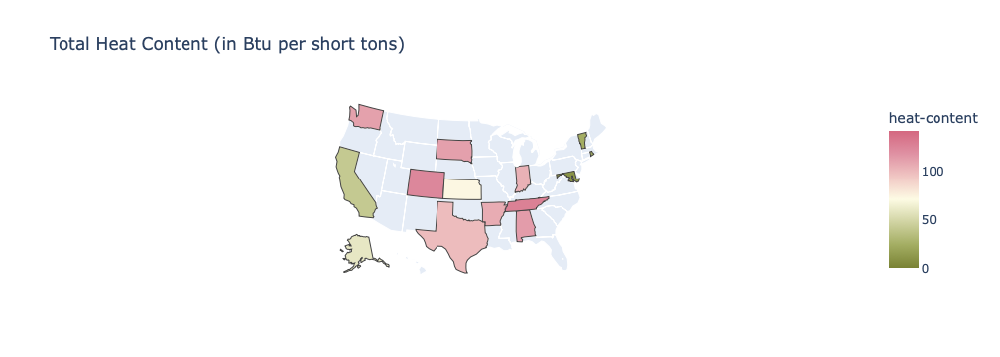

In [22]:
try:
    fig = px.choropleth(heat_content, 
                        locations = 'location',
                        locationmode = 'USA-states',
                        scope = 'usa',
                        color = 'heat-content',
                        hover_name = 'location',
                        hover_data = ['stateDescription', 'heat-content'],
                        range_color = [0,heat_content["heat-content"].max()],
                        color_continuous_scale = 'armyrose',
                        title = 'Total Heat Content (in Btu per short tons)')
    fig.show()
except:
    pass

In [23]:
fig.write_html("total_heat_content.html")

### Plot heat content per electric power generation across US states

In [24]:
heat_content["heat_per_gen"] = heat_content["heat-content"]/heat_content["generation"]

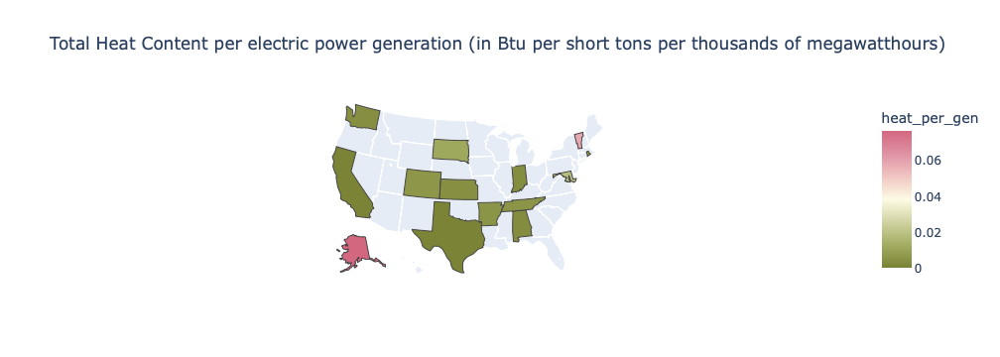

In [25]:
try:
    fig = px.choropleth(heat_content, 
                        locations = 'location',
                        locationmode = 'USA-states',
                        scope = 'usa',
                        color = 'heat_per_gen',
                        hover_name = 'location',
                        hover_data = ["stateDescription",'heat_per_gen', 'heat-content'],
                        range_color = [0, heat_content["heat_per_gen"].max()],
                        color_continuous_scale = 'armyrose',
                        title = 'Total Heat Content per electric power generation (in Btu per short tons per thousands of megawatthours)')
    fig.show()
except:
    pass

In [26]:
fig.write_html("total_heat_content_per_electric_power_genration.html")

### Plot heat content per capita across US states

In [27]:
heat_content["heat_per_capita"] = heat_content["heat-content"]/heat_content["population"]

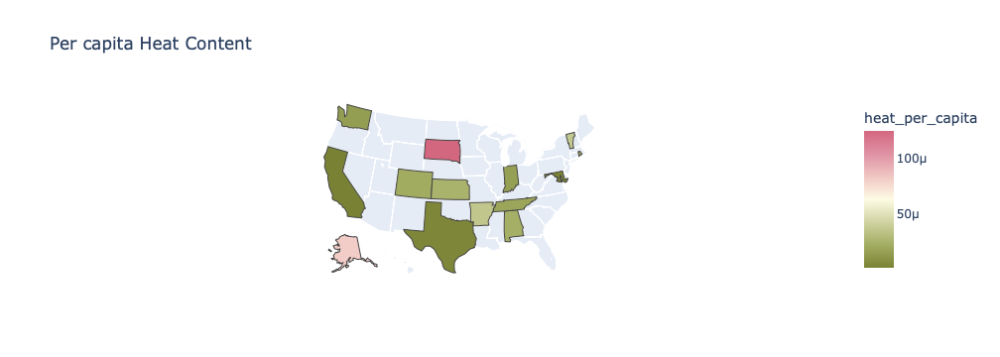

In [28]:
try:
    fig = px.choropleth(heat_content, 
                        locations = 'location',
                        locationmode = 'USA-states',
                        scope = 'usa',
                        color = 'heat_per_capita',
                        hover_name = 'location',
                        hover_data = ["stateDescription",'heat_per_capita', 'heat-content'],
                        range_color = [0, heat_content["heat_per_capita"].max()],
                        color_continuous_scale = 'armyrose',
                        title = 'Per capita Heat Content')
    fig.show()
except:
    pass

In [29]:
fig.write_html("total_heat_content_per_capita.html")

### Generate sulphur content dataframe

In [30]:
sulfur_content = pd.DataFrame(df2[["stateDescription", "location", "sulfur-content", "generation", "population"]].groupby(["stateDescription", "location", "population"]).sum())

In [31]:
sulfur_content = sulfur_content.reset_index()

### Plot sulphur content% across US states

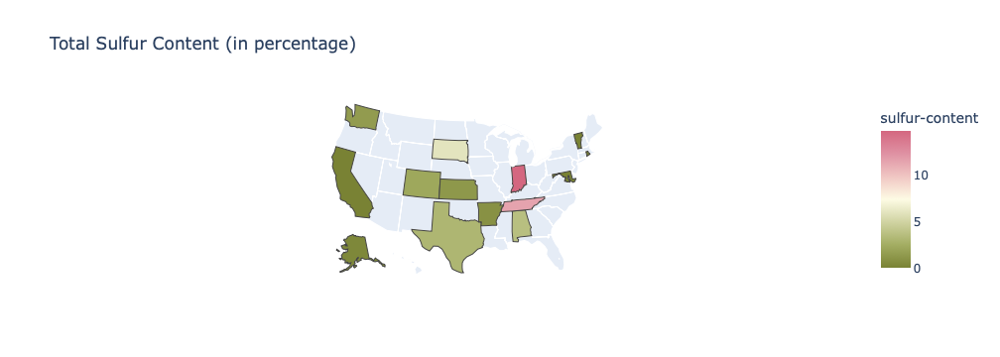

In [32]:
try:
    fig = px.choropleth(sulfur_content, 
                        locations = 'location',
                        locationmode = 'USA-states',
                        scope = 'usa',
                        color = 'sulfur-content',
                        hover_name = 'location',
                        hover_data = ["stateDescription", 'sulfur-content'],
                        range_color = [0,sulfur_content["sulfur-content"].max()],
                        color_continuous_scale = 'armyrose',
                        title = 'Total Sulfur Content (in percentage)')
    fig.show()
except:
    pass

In [33]:
fig.write_html("total_sulphur_content.html")

### Plot sulphur content per electric power generation across US states

In [34]:
sulfur_content["sulfur_per_gen"] = sulfur_content["sulfur-content"]/sulfur_content["generation"]

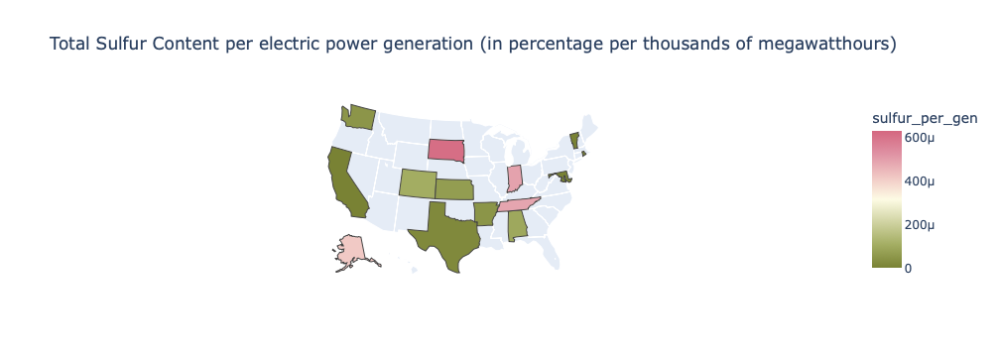

In [35]:
try:
    fig = px.choropleth(sulfur_content, 
                        locations = 'location',
                        locationmode = 'USA-states',
                        scope = 'usa',
                        color = 'sulfur_per_gen',
                        hover_name = 'location',
                        hover_data = ["stateDescription",'sulfur_per_gen', 'sulfur-content'],
                        range_color = [0, sulfur_content["sulfur_per_gen"].max()],
                        color_continuous_scale = 'armyrose',
                        title = 'Total Sulfur Content per electric power generation (in percentage per thousands of megawatthours)')
    fig.show()
except:
    pass

In [36]:
fig.write_html("total_sulphur_content_per_electric_power_generation.html")

### Plot sulphur content per capita across US states

In [38]:
sulfur_content["sulfur_per_capita"] = sulfur_content["sulfur-content"]/sulfur_content["population"]

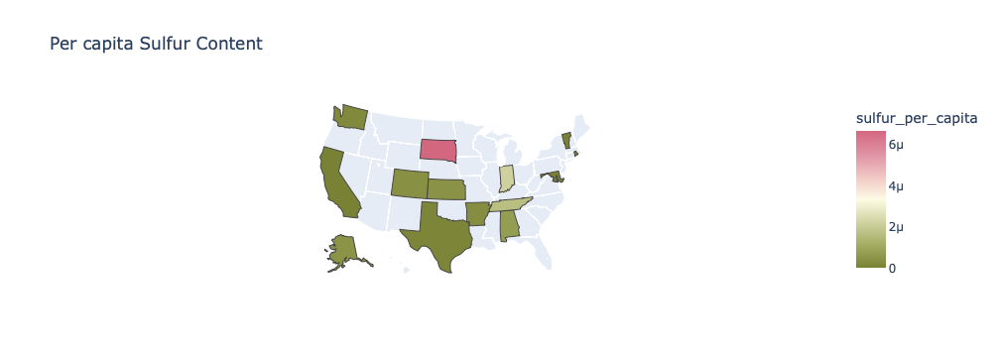

In [39]:
try:
    fig = px.choropleth(sulfur_content, 
                        locations = 'location',
                        locationmode = 'USA-states',
                        scope = 'usa',
                        color = 'sulfur_per_capita',
                        hover_name = 'location',
                        hover_data = ["stateDescription",'sulfur_per_capita', 'sulfur-content'],
                        range_color = [0, sulfur_content["sulfur_per_capita"].max()],
                        color_continuous_scale = 'armyrose',
                        title = 'Per capita Sulfur Content')
    fig.show()
except:
    pass

In [40]:
fig.write_html("total_sulphur_content_per_capita.html")

In [325]:
df = eia.loaders.load_dataframe(data="electric-power-operational-data")

/Users/nehamittal/data/eia-py/data/csv/electric-power-operational-data_data.csv


In [326]:
df['population'] = 0
df['Cancer_deaths'] = 0

In [327]:
pop_df = pd.read_csv("US_population.csv")

In [328]:
for j in range(len(pop_df)):
    for i in range(len(df)):
        if df.loc[i,"stateDescription"] == pop_df.loc[j,"States"]:
            df.loc[i, "population"] = int(pop_df.loc[j,"Annual Residential Population"].replace(',',''))
            df.loc[i, "Cancer_deaths"] = pop_df.loc[j,"Cancer Deaths"]

In [329]:
df2 = df.loc[df["sectorDescription"] == "Electric Power", :]
df3 = df.loc[df["sectorDescription"] == "All Sectors", :]
df4 = df.loc[df["sectorDescription"] == "Coal Consumption", :]

In [330]:
ash_content = pd.DataFrame(df2[["location", "ash-content", "generation", "population", "Cancer_deaths"]].groupby(["location", "population", "Cancer_deaths"]).sum())

In [331]:
ash_content = ash_content.reset_index()

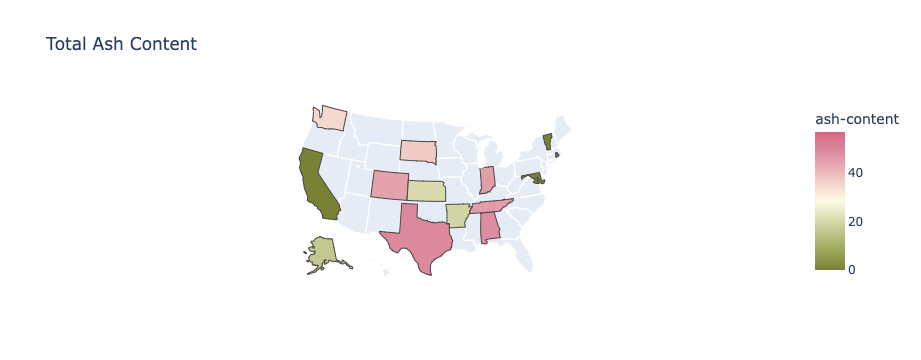

In [332]:
try:
    fig = px.choropleth(ash_content, 
                        locations = 'location',
                        locationmode = 'USA-states',
                        scope = 'usa',
                        color = 'ash-content',
                        hover_name = 'location',
                        hover_data = ['location', 'ash-content'],
                        range_color = [0,ash_content["ash-content"].max()],
                        color_continuous_scale = 'armyrose',
                        title = 'Total Ash Content')
    fig.show()
except:
    pass

In [333]:
ash_content["ash_by_gen"] = ash_content["ash-content"]/ash_content["generation"]

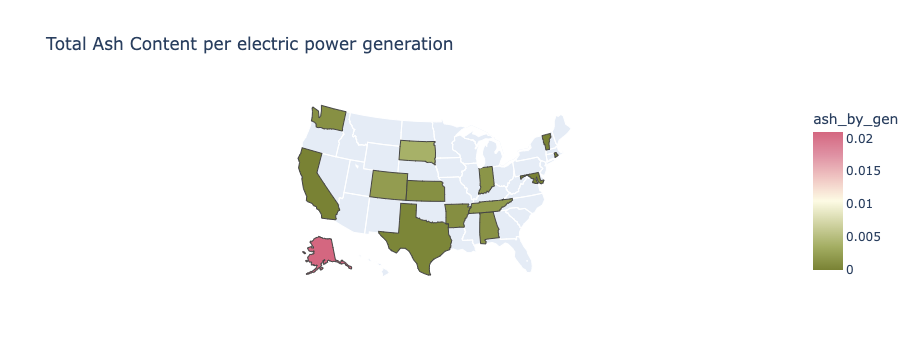

In [362]:
try:
    fig = px.choropleth(ash_content, 
                        locations = 'location',
                        locationmode = 'USA-states',
                        scope = 'usa',
                        color = 'ash_by_gen',
                        hover_name = 'location',
                        hover_data = ['location','ash_by_gen', 'ash-content'],
                        range_color = [0,ash_content["ash_by_gen"].max()],
                        color_continuous_scale = 'armyrose',
                        title = 'Total Ash Content per electric power generation')
    fig.show()
except:
    pass

In [335]:
ash_content["ash_per_capita"] = ash_content["ash-content"]/ash_content["population"]

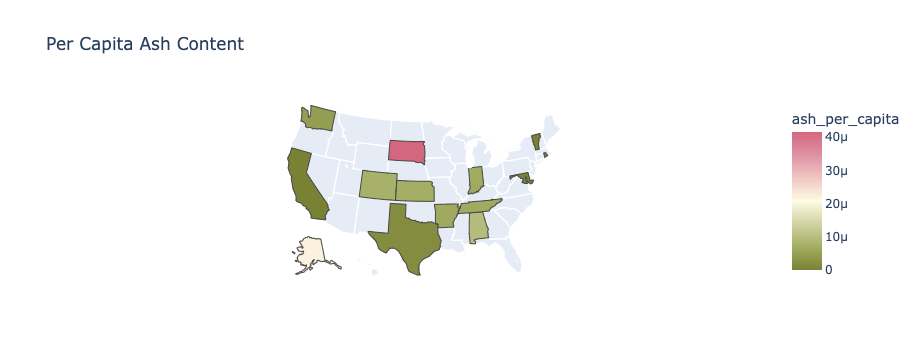

In [364]:
try:
    fig = px.choropleth(ash_content, 
                        locations = 'location',
                        locationmode = 'USA-states',
                        scope = 'usa',
                        color = 'ash_per_capita',
                        hover_name = 'location',
                        hover_data = ['location','ash_per_capita', 'ash-content'],
                        range_color = [0,ash_content["ash_per_capita"].max()],
                        color_continuous_scale = 'armyrose',
                        title = 'Per Capita Ash Content')
    fig.show()
except:
    pass

In [349]:
heat_content = pd.DataFrame(df2[["location", "heat-content", "generation", "population"]].groupby(["location", "population"]).sum())

In [350]:
heat_content = heat_content.reset_index()

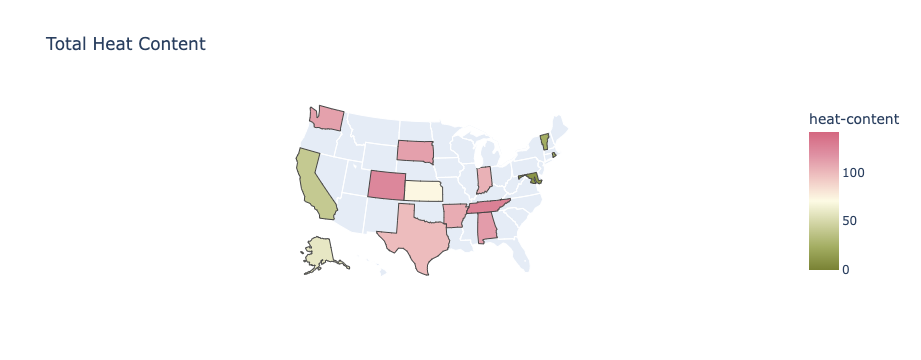

In [351]:
try:
    fig = px.choropleth(heat_content, 
                        locations = 'location',
                        locationmode = 'USA-states',
                        scope = 'usa',
                        color = 'heat-content',
                        hover_name = 'location',
                        hover_data = ['location', 'heat-content'],
                        range_color = [0,heat_content["heat-content"].max()],
                        color_continuous_scale = 'armyrose',
                        title = 'Total Heat Content')
    fig.show()
except:
    pass

In [352]:
heat_content["heat_by_gen"] = heat_content["heat-content"]/heat_content["generation"]

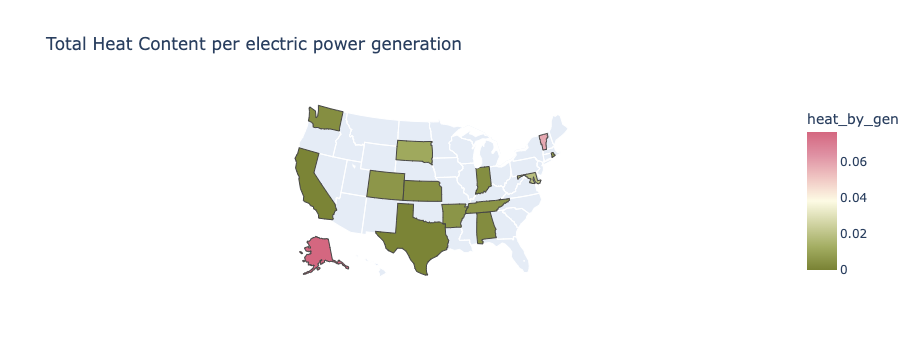

In [356]:
try:
    fig = px.choropleth(heat_content, 
                        locations = 'location',
                        locationmode = 'USA-states',
                        scope = 'usa',
                        color = 'heat_by_gen',
                        hover_name = 'location',
                        hover_data = ['location','heat_by_gen', 'heat-content'],
                        range_color = [0, heat_content["heat_by_gen"].max()],
                        color_continuous_scale = 'armyrose',
                        title = 'Total Heat Content per electric power generation')
    fig.show()
except:
    pass

In [354]:
heat_content["heat_per_capita"] = heat_content["heat-content"]/heat_content["population"]

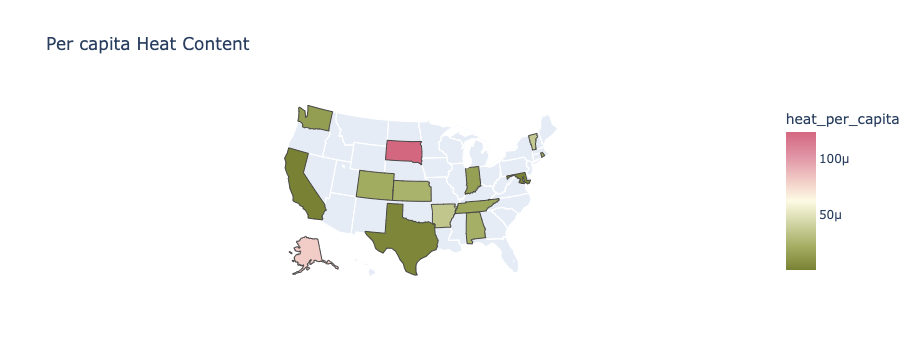

In [365]:
try:
    fig = px.choropleth(heat_content, 
                        locations = 'location',
                        locationmode = 'USA-states',
                        scope = 'usa',
                        color = 'heat_per_capita',
                        hover_name = 'location',
                        hover_data = ['location','heat_per_capita', 'heat-content'],
                        range_color = [0, heat_content["heat_per_capita"].max()],
                        color_continuous_scale = 'armyrose',
                        title = 'Per capita Heat Content')
    fig.show()
except:
    pass

In [357]:
sulfur_content = pd.DataFrame(df2[["location", "sulfur-content", "generation", "population"]].groupby(["location", "population"]).sum())

In [358]:
sulfur_content = sulfur_content.reset_index()

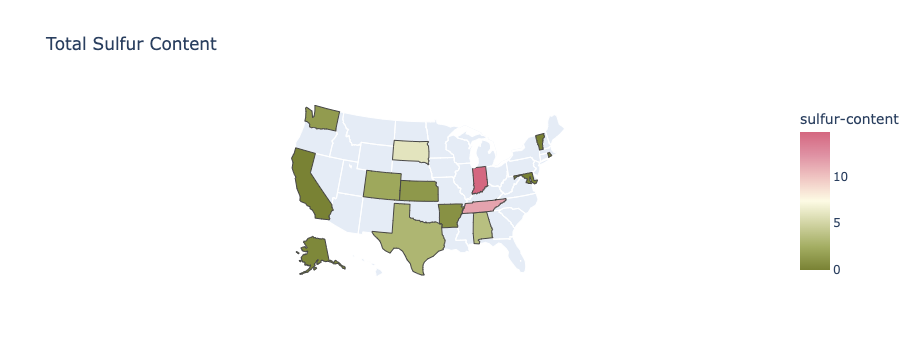

In [344]:
try:
    fig = px.choropleth(sulfur_content, 
                        locations = 'location',
                        locationmode = 'USA-states',
                        scope = 'usa',
                        color = 'sulfur-content',
                        hover_name = 'location',
                        hover_data = ['location', 'sulfur-content'],
                        range_color = [0,sulfur_content["sulfur-content"].max()],
                        color_continuous_scale = 'armyrose',
                        title = 'Total Sulfur Content')
    fig.show()
except:
    pass

In [345]:
sulfur_content["sulfur_by_gen"] = sulfur_content["sulfur-content"]/sulfur_content["generation"]

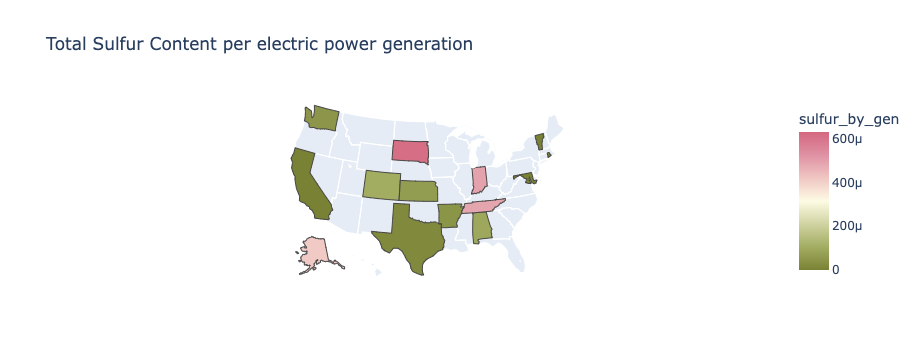

In [346]:
try:
    fig = px.choropleth(sulfur_content, 
                        locations = 'location',
                        locationmode = 'USA-states',
                        scope = 'usa',
                        color = 'sulfur_by_gen',
                        hover_name = 'location',
                        hover_data = ['location','sulfur_by_gen', 'sulfur-content'],
                        range_color = [0, sulfur_content["sulfur_by_gen"].max()],
                        color_continuous_scale = 'armyrose',
                        title = 'Total Sulfur Content per electric power generation')
    fig.show()
except:
    pass

In [359]:
sulfur_content["sulfur_per_capita"] = sulfur_content["sulfur-content"]/sulfur_content["population"]

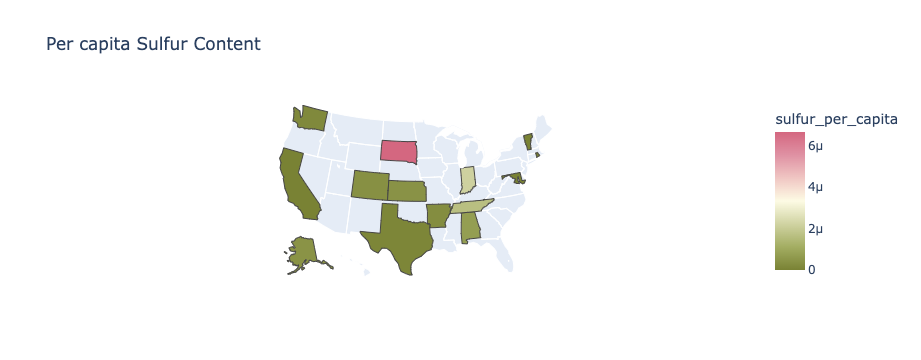

In [361]:
try:
    fig = px.choropleth(sulfur_content, 
                        locations = 'location',
                        locationmode = 'USA-states',
                        scope = 'usa',
                        color = 'sulfur_per_capita',
                        hover_name = 'location',
                        hover_data = ['location','sulfur_per_capita', 'sulfur-content'],
                        range_color = [0, sulfur_content["sulfur_per_capita"].max()],
                        color_continuous_scale = 'armyrose',
                        title = 'Per capita Sulfur Content')
    fig.show()
except:
    pass

In [313]:
df2.loc[(df["location"] == "SD") & (df["sectorDescription"] == "Electric Power"), ["fuelTypeDescription","ash-content"]]

,fuelTypeDescription,ash-content
0,all renewables,0.0
1,biomass,0.0
2,"coal, excluding waste coal",5.2
3,all coal products,5.2
4,distillate fuel oil,0.0
5,fossil fuels,5.2
97,all fuels,0.0
143,biomass,0.0
144,other renewables,0.0
145,other,0.0


### Loading data using the eia.loaders.load_dataframe method

We will analyze 'electric-power-operational-data' and try to find some interesting insights.

In [13]:
df = eia.loaders.load_dataframe(data="electric-power-operational-data")

/Users/priyanshbhatnagar/data/eia-py/data/csv/electric-power-operational-data_data.csv


In [14]:
df.head()

,Unnamed: 0,period,location,stateDescription,sectorid,sectorDescription,fueltypeid,fuelTypeDescription,generation,generation-units,...,cost,cost-units,cost-per-btu,cost-per-btu-units,sulfur-content,sulfur-content-units,ash-content,ash-content-units,heat-content,heat-content-units
0,0,2021-06,SD,South Dakota,98,Electric Power,AOR,all renewables,660.11939,thousand megawatthours,...,NaN,dollars per physical units,NaN,dollars per million Btu,0.00,percent,0.0,percent,0.000,Btu per physical units
1,1,2021-06,SD,South Dakota,98,Electric Power,BIO,biomass,0.00000,thousand megawatthours,...,NaN,dollars per physical units,NaN,dollars per million Btu,0.00,percent,0.0,percent,0.000,Btu per physical units
2,2,2021-06,SD,South Dakota,98,Electric Power,COL,"coal, excluding waste coal",205.22798,thousand megawatthours,...,NaN,dollars per short tons,NaN,dollars per million Btu,0.84,percent,5.2,percent,16.402,Btu per short tons
3,3,2021-06,SD,South Dakota,98,Electric Power,COW,all coal products,205.22798,thousand megawatthours,...,30.02,dollars per short tons,1.825,dollars per million Btu,0.84,percent,5.2,percent,16.402,Btu per short tons
4,4,2021-06,SD,South Dakota,98,Electric Power,DFO,distillate fuel oil,NaN,thousand megawatthours,...,NaN,dollars per short tons,NaN,dollars per million Btu,0.00,percent,0.0,percent,6.000,Btu per short tons


In [15]:
len(df)

5000

In [16]:
df["period"].unique()

array(['2021-06', '2021-07', '2021-08', '2021-09', '2022-02', '2022-03',
       '2022-04', '2021-10', '2021-11', '2021-12', '2022-01', '2021-05',
       '2021-04', '2022-05', '2010-03', '2010-01', '2010-02'],
      dtype=object)

In [45]:
states_generation = {}
for i in range(0, 5000):
    if (
        df["sectorDescription"][i] == "Electric Power"
        and df["fuelTypeDescription"][i] == "all renewables"
    ):
        states_generation[df["location"][i]] = df["generation"][i]

In [46]:
states_generation

{'SD': 777.64297,
 'CO': 1486.04431,
 'MTN': 5502.82573,
 'WA': 591.21657,
 'TX': 8791.92861,
 'PCC': 6800.40767,
 'CA': 5102.63562,
 'AL': 55.57365,
 'PR': 26.8152,
 'AR': 43.73692,
 'IN': 704.29153,
 'PCN': 140.81661,
 'TN': 39.36849,
 'KS': 2143.10626,
 'RI': 59.83523}

<BarContainer object of 15 artists>

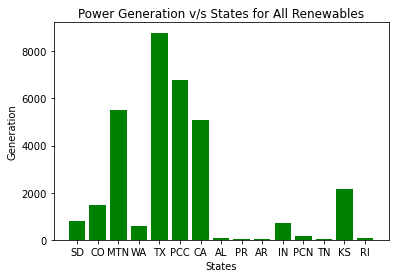

In [47]:
import matplotlib.pyplot as plt

plt.xlabel("States")
plt.ylabel("Generation")
plt.title("Power Generation v/s States for All Renewables")
plt.bar(states_generation.keys(), states_generation.values(), color="g")

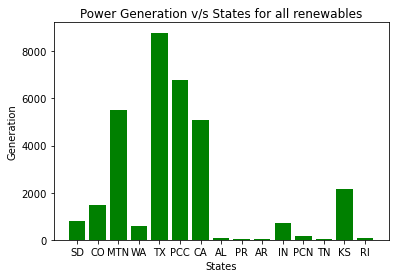

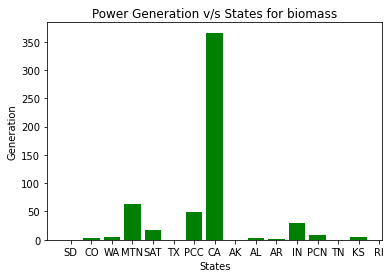

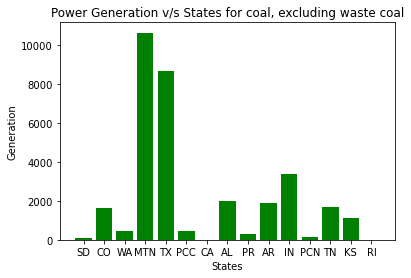

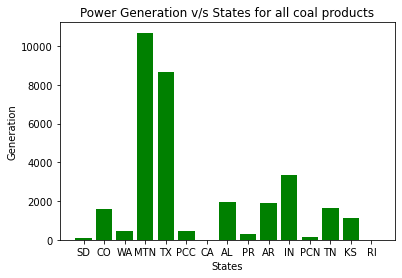

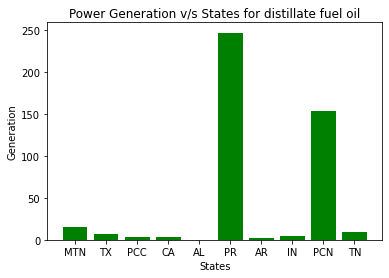

...

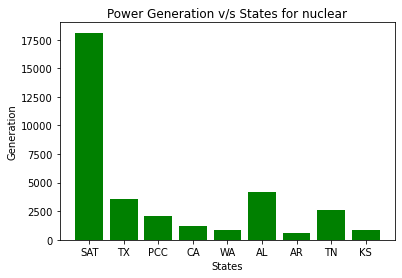

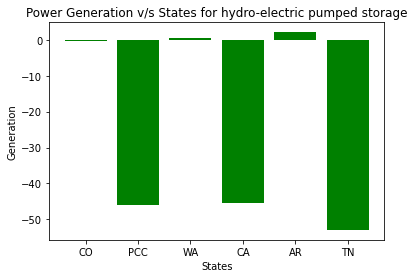

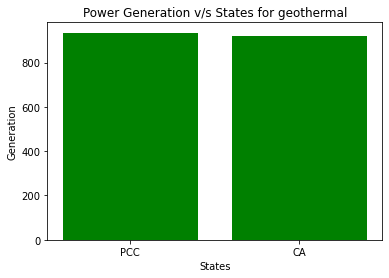

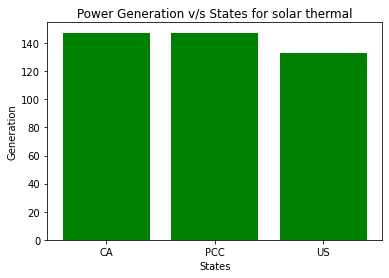

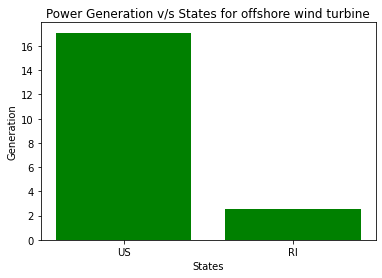

In [26]:
for fuel in df["fuelTypeDescription"].unique():
    states_generation = {}
    for i in range(0, 5000):
        if (
            df["sectorDescription"][i] == "Electric Power"
            and df["fuelTypeDescription"][i] == fuel
        ):
            states_generation[df["location"][i]] = df["generation"][i]
    plt.figure()
    plt.xlabel("States")
    plt.ylabel("Generation")
    plt.title("Power Generation v/s States for " + fuel)
    plt.bar(states_generation.keys(), states_generation.values(), color="g")

In [27]:
layout = dict(geo={"scope": "usa"})

In [28]:
layout

{'geo': {'scope': 'usa'}}

In [30]:
l = list(df["location"].unique())

In [37]:
data = dict(
    type="choropleth",
    locations=list(states_generation.keys()),
    locationmode="USA-states",
    z=list(states_generation.values()),
)

In [39]:
len(list(states_generation.values()))

15

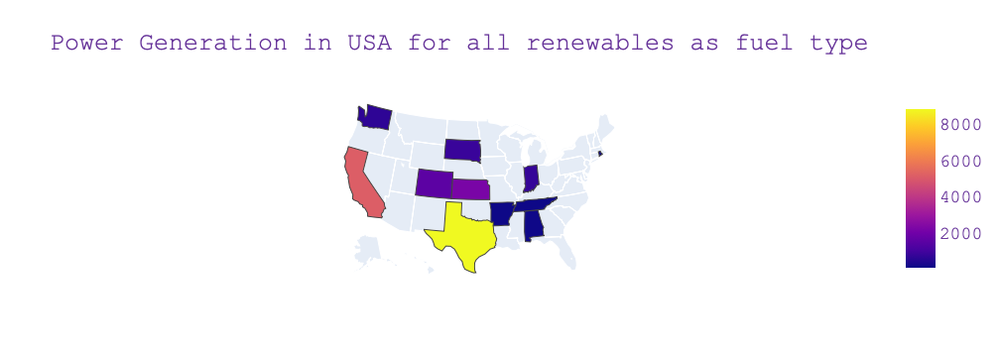

In [53]:
# For All Renewables as the fuel type, ....
x = pg.Figure(data=[data], layout=layout)
x.update_layout(
    title="Power Generation in USA for all renewables as fuel type",
    font=dict(family="Courier New, monospace", size=18, color="RebeccaPurple"),
)
po.iplot(x)

## Section 2: State Profiles and Retail Sales EDA 

This notebook has some EDA of the EIA API data

The following datasets have been analysed here:

- state-electricity-profiles-emissions-by-state-by-fuel
- state-electricity-profiles-source-disposition
- state-electricity-profiles-capability
- state-electricity-profiles-source-disposition
- state-electricity-profiles-summary

In [3]:
l=['electric-power-operational-data','facility-fuel', 'operating-generator-capacity', 'retail-sales', 'rto-daily-fuel-type-data', 'rto-daily-interchange-data', 'rto-daily-region-data','rto-daily-region-sub-ba-data', 'rto-fuel-type-data','rto-interchange-data','rto-region-data', 'rto-region-sub-ba-data', 'state-electricity-profiles-capability', 'state-electricity-profiles-emissions-by-state-by-fuel', 'state-electricity-profiles-meters', 'state-electricity-profiles-net-metering', 'state-electricity-profiles-source-disposition','state-electricity-profiles-summary']

### Load state-electricity-profiles-emissions-by-state-by-fuel data

In [4]:
emission_df=eia.loaders.load_dataframe(data='state-electricity-profiles-emissions-by-state-by-fuel')

In [5]:
#Taking a peek at the loaded dataframe
emission_df[(emission_df['period']=="2020") & (emission_df["stateDescription"]=="Alabama")]

,Unnamed: 0,period,stateid,stateDescription,fuelid,fuelDescription,so2-rate-lbs-mwh,so2-short-tons,nox-rate-lbs-mwh,nox-short-tons,co2-rate-lbs-mwh,co2-thousand-metric-tons,so2-rate-lbs-mwh-units,so2-short-tons-units,nox-rate-lbs-mwh-units,nox-short-tons-units,co2-rate-lbs-mwh-units,co2-thousand-metric-tons-units
0,0.0,2020,AL,Alabama,COL,Coal,NaN,3164,NaN,8315,NaN,21156,pounds per megawatthour,short tons,pounds per megawatthour,short tons,pounds per megawatthour,thousand metric tons
207,207.0,2020,AL,Alabama,ALL,Total,0.4,28757,0.3,22882,718.0,44895,pounds per megawatthour,short tons,pounds per megawatthour,short tons,pounds per megawatthour,thousand metric tons
252,252.0,2020,AL,Alabama,PET,Petroleum,NaN,60,NaN,41,NaN,29,pounds per megawatthour,short tons,pounds per megawatthour,short tons,pounds per megawatthour,thousand metric tons
253,253.0,2020,AL,Alabama,OTH,Other,NaN,25413,NaN,6198,NaN,0,pounds per megawatthour,short tons,pounds per megawatthour,short tons,pounds per megawatthour,thousand metric tons
254,254.0,2020,AL,Alabama,NG,Natural Gas,NaN,120,NaN,8328,NaN,23711,pounds per megawatthour,short tons,pounds per megawatthour,short tons,pounds per megawatthour,thousand metric tons


In [6]:
# Cleaning up the dataframe
emission_df=emission_df.drop(emission_df[emission_df['period']=='period'].index)

In [7]:
# Filtering the dataframe
emission_df=emission_df[emission_df['fuelDescription']=="Total"]

In [8]:
# Finding the list of the states in the dataframe
emission_df['stateDescription'].unique()

array(['Wyoming', 'West Virginia', 'Wisconsin', 'Utah', 'United States',
       'Texas', 'Washington', 'Vermont', 'Virginia', 'Tennessee',
       'New Mexico', 'Rhode Island', 'Pennsylvania', 'Oregon', 'Oklahoma',
       'South Dakota', 'South Carolina', 'Ohio', 'New York', 'Nevada',
       'Michigan', 'Maine', 'North Dakota', 'North Carolina', 'Montana',
       'New Jersey', 'New Hampshire', 'Nebraska', 'Mississippi',
       'Missouri', 'Minnesota', 'Maryland', 'Hawaii', 'Georgia',
       'Kentucky', 'Kansas', 'Indiana', 'Illinois', 'Massachusetts',
       'Louisiana', 'Idaho', 'Iowa', 'Alabama', 'Alaska', 'Connecticut',
       'Colorado', 'California', 'Arizona', 'Florida', 'Delaware',
       'District of Columbia', 'Arkansas'], dtype=object)

In [9]:
# listing down all the columns in the dataframe
emission_df.columns

Index(['Unnamed: 0', 'period', 'stateid', 'stateDescription', 'fuelid',
       'fuelDescription', 'so2-rate-lbs-mwh', 'so2-short-tons',
       'nox-rate-lbs-mwh', 'nox-short-tons', 'co2-rate-lbs-mwh',
       'co2-thousand-metric-tons', 'so2-rate-lbs-mwh-units',
       'so2-short-tons-units', 'nox-rate-lbs-mwh-units',
       'nox-short-tons-units', 'co2-rate-lbs-mwh-units',
       'co2-thousand-metric-tons-units'],
      dtype='object')

In [10]:
# Type conversion
emission_df=emission_df.astype({'co2-rate-lbs-mwh':'float'})
emission_df=emission_df.astype({'nox-rate-lbs-mwh':'float'})
emission_df=emission_df.astype({'so2-rate-lbs-mwh':'float'})

### Emission Characteristics
Over the next 3 cells we check if the per unit emission of CO2, NOx and SO2 over the years have changed. 0 corresponds to the latest data and 7000 corresponds to 1990 data.

In [11]:
emission_df['nox-rate-lbs-mwh'].info()

<class 'pandas.core.series.Series'>
Int64Index: 1560 entries, 1 to 7564
Series name: nox-rate-lbs-mwh
Non-Null Count  Dtype  
--------------  -----  
1560 non-null   float64
dtypes: float64(1)
memory usage: 24.4 KB


<AxesSubplot:>

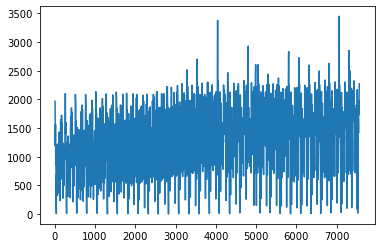

In [12]:
emission_df['co2-rate-lbs-mwh'].plot()

<AxesSubplot:>

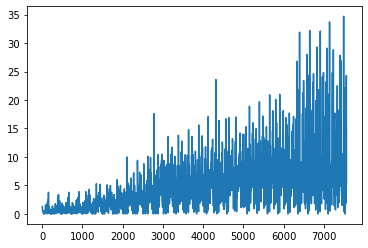

In [13]:
emission_df['so2-rate-lbs-mwh'].plot()

<AxesSubplot:>

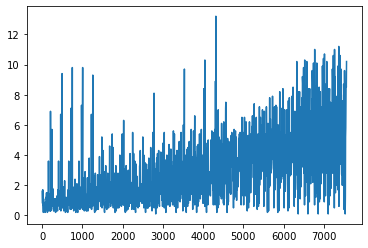

In [14]:
emission_df['nox-rate-lbs-mwh'].plot()

### Inference

The emisison per unit electricity generation over the years seems to be decreasing. This could be due to improved techniques/ increase in non polluting electricity generation.

### Green Score and SO2 Score

<B>Green Score</B>: This score is a value between 0 (Poor) and 5 (Best) and measures the environmental impact of electricity generation. Green score takes into consideration the primary contributors to global warming [NOx and CO2]. This score scales NOx to CO2 equivalent and normalises the value to per unit of electricity generation.

<B>SO2 Score</B>: This score is a value between 0 (Best) and 5 (Poor) and measures the amount of SO2 emission during electricity generation. This again is normalised per unit of electricity generation. 

<B> References/Readings</B>: 

- https://www.epa.gov/ghgemissions/overview-greenhouse-gases#carbon-dioxide
- https://www.ipcc.ch/report/ar4/syr/
- https://www.ipcc.ch/site/assets/uploads/2018/02/ar4_syr_full_report.pdf
- https://www.epa.gov/so2-pollution/sulfur-dioxide-basics

### Green Score

In [15]:
emission_df['green_score']=emission_df['nox-rate-lbs-mwh']*298+emission_df['co2-rate-lbs-mwh']
emission_df['green_score_norm']=(emission_df['green_score']-emission_df['green_score'].mean())/emission_df['green_score'].std()
emission_df['green_score_norm']=emission_df['green_score_norm']-emission_df['green_score_norm'].min()
maximum= emission_df[emission_df['stateid']!='US']['green_score_norm'].max()
emission_df['green_score_norm']=5-emission_df['green_score_norm']*5/maximum

In [16]:
fig = px.choropleth(emission_df[emission_df["fuelDescription"]=="Total"].sort_values(["period"]),
                    locations='stateid',
                    color='green_score_norm',
                    color_continuous_scale=px.colors.diverging.RdYlGn,
                    hover_name='stateDescription',
                    animation_frame='period',
                    locationmode='USA-states',
                    range_color=(0, 5),
                    labels={'green_score_norm':'Green Score'},
                    scope='usa')

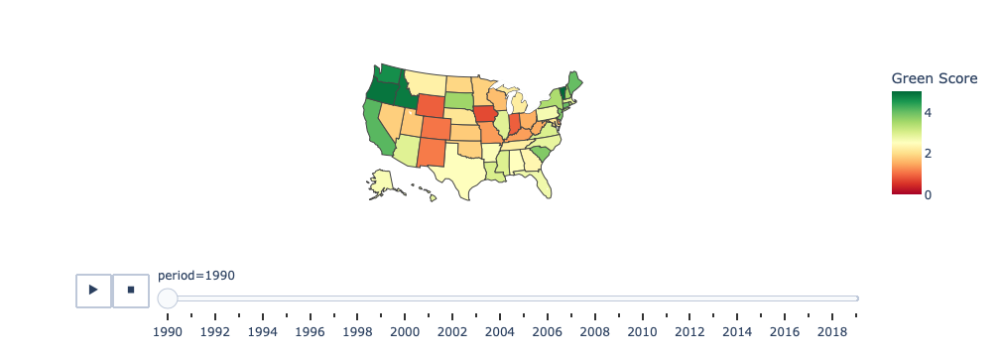

In [17]:
fig.show()

### Inference

The Green Score has been improving over the years, meaning decision makers are pushing more towards greener sources of energy. This essentially could be due to improved power generation techniques.

### Green Score Ranking (State-wise, 2020)

In [18]:
#Best to Worst
emission_df[emission_df["period"]=="2020"].sort_values(["green_score_norm"],ascending=False)[["stateDescription","green_score_norm"]].reset_index(drop=True)

,stateDescription,green_score_norm
0,Washington,4.800611
1,New Hampshire,4.796714
2,Vermont,4.763041
3,Idaho,4.692732
4,South Dakota,4.691485
5,Oregon,4.655318
6,New York,4.576435
7,South Carolina,4.552895
8,New Jersey,4.535747
9,Connecticut,4.529511


In [19]:
# Worst to Best
emission_df[emission_df["period"]=="2020"].sort_values(["green_score_norm"])[["stateDescription","green_score_norm"]].reset_index(drop=True)

,stateDescription,green_score_norm
0,Alaska,2.458610
1,District of Columbia,2.780220
2,Hawaii,2.932841
3,Wyoming,3.118355
4,West Virginia,3.268793
5,Missouri,3.395691
6,Utah,3.411592
7,Kentucky,3.447916
8,Indiana,3.462570
9,North Dakota,3.560939


In [20]:
fig.write_html("Green_Score_Map.html")

### SO2 Score

In [21]:
emission_df['so2_index']= (emission_df['so2-rate-lbs-mwh']-emission_df['so2-rate-lbs-mwh'].mean())/emission_df['so2-rate-lbs-mwh'].std()
emission_df['so2_index']=emission_df['so2_index']-emission_df['so2_index'].min()
maximum= emission_df[emission_df['stateid']!='US']['so2_index'].max()
emission_df['so2_index']=emission_df['so2_index']*5/maximum

In [22]:
fig1 = px.choropleth(emission_df[emission_df["fuelDescription"]=="Total"].sort_values(["period"]),
                    locations='stateid',
                    color='so2_index',
                    color_continuous_scale=px.colors.diverging.RdYlGn_r,
                    hover_name='stateDescription',
                    animation_frame='period',
                    locationmode='USA-states',
                    range_color=(0, 5),
                    labels={'so2_index':'SO2 Score'},
                    scope='usa')

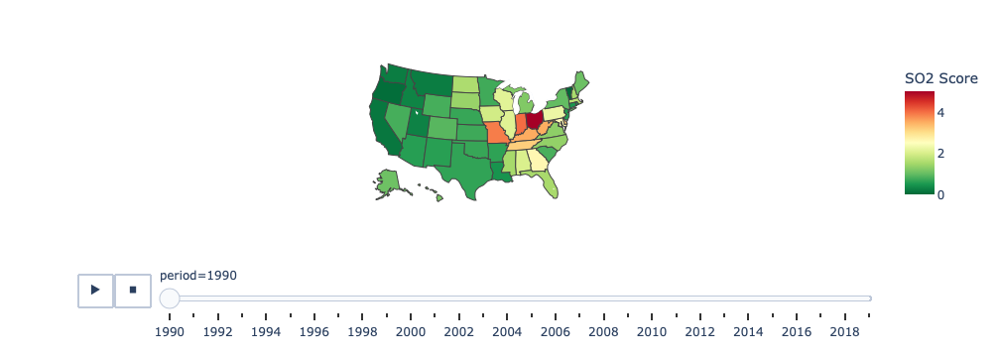

In [23]:
fig1.show()

### Inference:
The SO2 score has been getting better over the years. This could be due to using fuel sources with lower Sulphur content.

### SO2 Score Ranking (State-wise, 2020)

In [24]:
# Best to Worst
emission_df[emission_df["period"]=="2020"].sort_values(["so2_index"])[["stateDescription","so2_index"]].reset_index(drop=True)

,stateDescription,so2_index
0,Rhode Island,0.000000
1,District of Columbia,0.000000
2,Connecticut,0.000000
3,California,0.000000
4,Vermont,0.000000
5,New Hampshire,0.000000
6,Nevada,0.014409
7,New York,0.014409
8,South Dakota,0.014409
9,New Jersey,0.014409


In [25]:
# Worst to Best
emission_df[emission_df["period"]=="2020"].sort_values(["so2_index"], ascending=False)[["stateDescription","so2_index"]].reset_index(drop=True)

,stateDescription,so2_index
0,Hawaii,0.547550
1,Missouri,0.360231
2,Nebraska,0.317003
3,North Dakota,0.244957
4,Ohio,0.216138
5,Wyoming,0.187320
6,Kentucky,0.187320
7,Maine,0.187320
8,West Virginia,0.172911
9,Arkansas,0.172911


In [26]:
fig1.write_html("SO2_Score_Map.html")

### Load state-electricity-profiles-capability

In [27]:
ll=['state-electricity-profiles-capability', 'state-electricity-profiles-emissions-by-state-by-fuel', 'state-electricity-profiles-meters', 'state-electricity-profiles-net-metering']
capability_df=eia.loaders.load_dataframe(data=ll[0])

In [28]:
# Take a peek
capability_df[(capability_df['stateDescription']=='Illinois') & (capability_df['period']=='2020')]

,Unnamed: 0,period,stateId,stateDescription,producertypeid,producerTypeDescription,energysourceid,energySourceDescription,capability,capability-units
1,1.0,2020,IL,Illinois,IPP,Independent Power Producers,HYC,Hydroelectric,22.1,megawatts
2,2.0,2020,IL,Illinois,IPP,Independent Power Producers,COL,Coal,9177.0,megawatts
3,3.0,2020,IL,Illinois,IPP,Independent Power Producers,BAT,Battery,132.4,megawatts
4,4.0,2020,IL,Illinois,IPP,Independent Power Producers,ALL,All,40544.3,megawatts
5,5.0,2020,IL,Illinois,EU,Electric Utilities,WND,Wind,6.3,megawatts
6,6.0,2020,IL,Illinois,EU,Electric Utilities,SOLPV,Solar - PV,1.3,megawatts
7,7.0,2020,IL,Illinois,EU,Electric Utilities,SOL,Solar,1.3,megawatts
8,8.0,2020,IL,Illinois,EU,Electric Utilities,PETIC,Petroleum - IC,280.5,megawatts
9,9.0,2020,IL,Illinois,EU,Electric Utilities,PETGT,Petroleum - GT,59.1,megawatts
10,10.0,2020,IL,Illinois,EU,Electric Utilities,PET,Petroleum,339.6,megawatts


In [29]:
# Finding Unique Energy Sources
capability_df['energySourceDescription'].unique()

array(['All', 'Hydroelectric', 'Coal', 'Battery', 'Wind', 'Solar - PV',
       'Solar', 'Petroleum - IC', 'Petroleum - GT', 'Petroleum',
       'Other Biomass', 'Natural Gas - ST', 'Natural Gas - IC',
       'Natural Gas - GT', 'Natural Gas - CC', 'Natural Gas', 'Wood',
       'Other', 'Geothermal', 'Pumped Storage', 'Petroleum - ST',
       'Petroleum - OTH', 'Other Gas', 'Nuclear', 'Solar - TH',
       'Natural Gas - OTH', 'energySourceDescription'], dtype=object)

In [30]:
# Take a peek for a sepcific state and period
capability_df[(capability_df['stateDescription']=="Alabama") & (capability_df['period']=="2020")]

,Unnamed: 0,period,stateId,stateDescription,producertypeid,producerTypeDescription,energysourceid,energySourceDescription,capability,capability-units
1249,1249.0,2020,AL,Alabama,TOT,All sectors,WOO,Wood,612.2,megawatts
1250,1250.0,2020,AL,Alabama,TOT,All sectors,SOLPV,Solar - PV,194.1,megawatts
1251,1251.0,2020,AL,Alabama,TOT,All sectors,SOL,Solar,194.1,megawatts
1252,1252.0,2020,AL,Alabama,TOT,All sectors,PETIC,Petroleum - IC,26.6,megawatts
1253,1253.0,2020,AL,Alabama,TOT,All sectors,PETGT,Petroleum - GT,16.0,megawatts
1254,1254.0,2020,AL,Alabama,TOT,All sectors,PET,Petroleum,42.6,megawatts
1255,1255.0,2020,AL,Alabama,TOT,All sectors,OOG,Other Gas,19.8,megawatts
1256,1256.0,2020,AL,Alabama,TOT,All sectors,OBM,Other Biomass,6.4,megawatts
1257,1257.0,2020,AL,Alabama,TOT,All sectors,NUC,Nuclear,5544.5,megawatts
1258,1258.0,2020,AL,Alabama,TOT,All sectors,NGST,Natural Gas - ST,1857.4,megawatts


In [31]:
capability_df=capability_df.drop(capability_df[capability_df['period']=='period'].index)

In [32]:
capability_df=capability_df.astype({'capability':float})
capability_df[capability_df['stateDescription']=='United States']

,Unnamed: 0,period,stateId,stateDescription,producertypeid,producerTypeDescription,energysourceid,energySourceDescription,capability,capability-units
914,914.0,2020,US,United States,TOT,All sectors,WOO,Wood,8326.5,megawatts
915,915.0,2020,US,United States,TOT,All sectors,WND,Wind,118378.7,megawatts
916,916.0,2020,US,United States,TOT,All sectors,SOLTH,Solar - TH,1747.9,megawatts
1001,1001.0,2020,US,United States,TOT,All sectors,SOLPV,Solar - PV,46306.2,megawatts
1002,1002.0,2020,US,United States,TOT,All sectors,SOL,Solar,48054.1,megawatts
...,...,...,...,...,...,...,...,...,...,...
44645,4637.0,1990,US,United States,TOT,All sectors,PET,Petroleum,77502.0,megawatts
44646,4638.0,1990,US,United States,TOT,All sectors,HPS,Pumped Storage,19462.0,megawatts
44647,4639.0,1990,US,United States,TOT,All sectors,SOL,Solar,313.0,megawatts
44648,4640.0,1990,US,United States,TOT,All sectors,WND,Wind,1800.0,megawatts


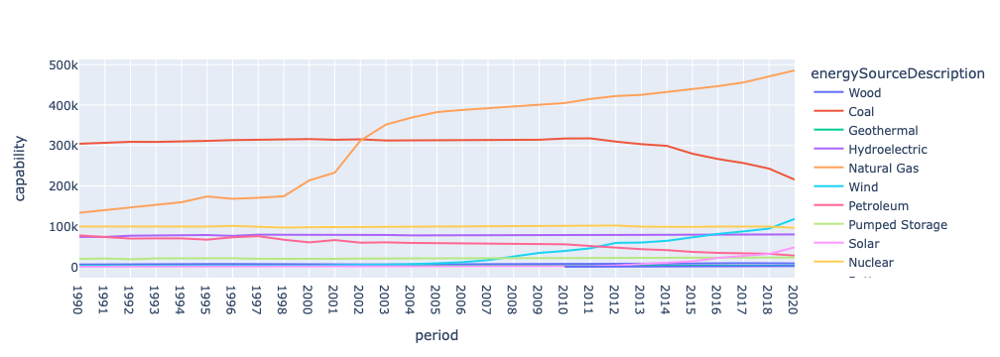

In [33]:
fig = px.line(capability_df[(capability_df['stateDescription']=='United States') & (capability_df['energySourceDescription'].isin(['Hydroelectric', 'Coal', 'Battery', 'Wind','Solar','Petroleum', 'Natural Gas', 'Wood', 'Geothermal', 'Pumped Storage', 'Nuclear'])) & (capability_df["producertypeid"]=="TOT")].sort_values(by=['period']), x="period", y="capability", color='energySourceDescription')
fig.show()
fig.write_html("capability.html")

### Inference:
This plot shows the electricity generated from some of the major sources such as Coal, Natural Gas, Wind, etc. The amount of coal used in electricity generation has been steadily decreasing since 2010. Natural Gas has been increasing and so are renewable sources such as wind, solar, etc. This is probably one of the reasons why the green score and SO2 scores have been improving over the years.

### Load state-electricity-profiles-source-disposition

In [34]:
source_disposition_df=eia.loaders.load_dataframe(data="state-electricity-profiles-source-disposition")

In [35]:
# Take a peek
source_disposition_df

,Unnamed: 0,period,state,stateDescription,electric-utilities,independent-power-producers,combined-heat-and-pwr-elect,elect-pwr-sector-gen-subtotal,combined-heat-and-pwr-comm,combined-heat-and-pwr-indust,...,energy-only-providers-units,facility-direct-units,total-elect-indust-units,direct-use-units,total-international-exports-units,estimated-losses-units,net-interstate-trade-units,unaccounted-units,total-disposition-units,net-trade-index-units
0,0,2020,AZ,Arizona,91617412,17430377,108528,109156317,148740,0,...,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,ratio
1,1,2020,WY,Wyoming,36693200,3310295,0,40003495,0,2007494,...,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,ratio
2,2,2020,WV,West Virginia,40783193,14593742,0,55376935,0,1284598,...,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,ratio
3,3,2020,WI,Wisconsin,47373949,11344864,937443,59656256,139527,1652762,...,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,ratio
4,4,2020,WA,Washington,100652726,13360168,0,114012894,24125,2077449,...,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,ratio
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1555,1555,1990,VT,Vermont,4992578,133799,0,5126377,0,37731,...,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,ratio
1556,1556,1990,WA,Washington,100478861,176850,8460,100664171,100626,1306738,...,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,ratio
1557,1557,1990,WI,Wisconsin,45550958,110156,22651,45683765,20287,2064804,...,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,ratio
1558,1558,1990,WV,West Virginia,77363692,250443,0,77614135,0,1925409,...,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,megawatthours,ratio


In [36]:
# List down the columns
source_disposition_df.columns

Index(['Unnamed: 0', 'period', 'state', 'stateDescription',
       'electric-utilities', 'independent-power-producers',
       'combined-heat-and-pwr-elect', 'elect-pwr-sector-gen-subtotal',
       'combined-heat-and-pwr-comm', 'combined-heat-and-pwr-indust',
       'indust-and-comm-gen-subtotal', 'total-net-generation',
       'total-international-imports', 'total-supply', 'full-service-providers',
       'energy-only-providers', 'facility-direct', 'total-elect-indust',
       'direct-use', 'total-international-exports', 'estimated-losses',
       'net-interstate-trade', 'unaccounted', 'total-disposition',
       'net-trade-index', 'electric-utilities-units',
       'independent-power-producers-units',
       'combined-heat-and-pwr-elect-units',
       'elect-pwr-sector-gen-subtotal-units',
       'combined-heat-and-pwr-comm-units',
       'combined-heat-and-pwr-indust-units',
       'indust-and-comm-gen-subtotal-units', 'total-net-generation-units',
       'total-international-import

In [37]:
# Calculate IPP_Ratio which is a measure of how much electricity privately owned entities generate power
source_disposition_df['IPP_ratio']=source_disposition_df['independent-power-producers']/source_disposition_df['elect-pwr-sector-gen-subtotal']

In [38]:
source_disposition_df['IPP_ratio']

0       0.159683
1       0.082750
2       0.263535
3       0.190171
4       0.117181
          ...   
1555    0.026100
1556    0.001757
1557    0.002411
1558    0.003227
1559    0.000000
Name: IPP_ratio, Length: 1560, dtype: float64

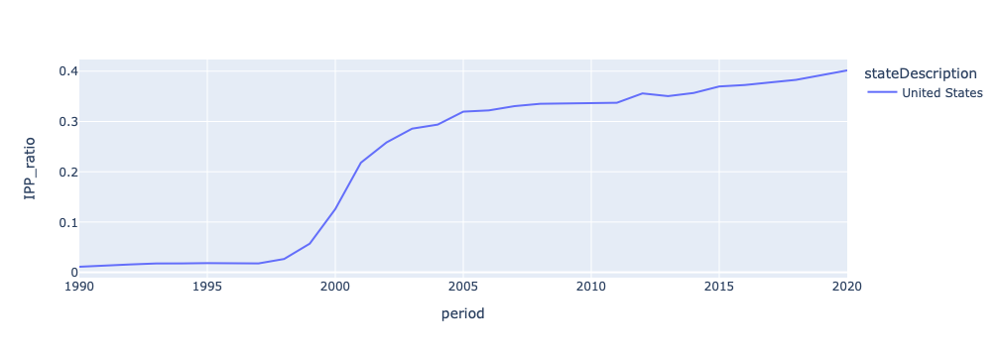

In [39]:
fig = px.line(source_disposition_df[source_disposition_df['stateDescription']=='United States'], x="period", y="IPP_ratio", color='stateDescription')
fig.show()
fig.write_html("IPP.html")

### Inference:

The share of private power producers has been increasing over the years and is now almost 40% of the total electricity production in the US.

### Load state-electricity-profiles-summary

In [40]:
summary= eia.loaders.load_dataframe(data='state-electricity-profiles-summary')

In [41]:
#List the columns
summary.columns

Index(['Unnamed: 0', 'period', 'stateID', 'stateDescription',
       'net-summer-capacity', 'net-summer-capacity-rank',
       'capacity-elec-utilities', 'capacity-elect-utilities-rank',
       'capacity-ipp', 'capacity-ipp-rank', 'net-generation',
       'net-generation-rank', 'generation-elect-utils',
       'generation-elect-utils-rank', 'generation-ipp', 'generation-ipp-rank',
       'sulfer-dioxide', 'sulfer-dioxide-rank', 'nitrogen-oxide',
       'nitrogen-oxide-rank', 'carbon-dioxide', 'carbon-dioxide-rank',
       'sulfer-dioxide-lbs', 'sulfer-dioxide-rank-lbs', 'nitrogen-oxide-lbs',
       'nitrogen-oxide-rank-lbs', 'carbon-dioxide-lbs',
       'carbon-dioxide-rank-lbs', 'total-retail-sales',
       'total-retail-sales-rank', 'fsp-service-provider-sales',
       'fsp-sales-rank', 'eop-sales', 'eop-sales-rank', 'direct-use',
       'direct-use-rank', 'average-retail-price', 'average-retail-price-rank',
       'prime-source', 'net-summer-capacity-units',
       'net-summer-capac

In [42]:
# List of States
summary['stateID'].unique()

array(['DC', 'DE', 'WV', 'WI', 'WA', 'VT', 'VA', 'UT', 'US', 'TX', 'CT',
       'CO', 'CA', 'AZ', 'AR', 'AL', 'AK', 'NE', 'ND', 'NC', 'MT', 'MS',
       'MO', 'MN', 'MI', 'ME', 'MD', 'MA', 'LA', 'KY', 'IN', 'IL', 'ID',
       'TN', 'SD', 'SC', 'RI', 'PA', 'OR', 'OK', 'OH', 'NY', 'NV', 'NM',
       'NJ', 'NH', 'HI', 'GA', 'FL', 'WY', 'KS', 'IA'], dtype=object)

In [43]:
fig1 = px.choropleth(summary[summary["stateID"]!="US"].sort_values(["period"]),
                    locations='stateID',
                    color='total-retail-sales',
                    hover_name='stateDescription',
                    animation_frame='period',
                    locationmode='USA-states',
                    labels={'revenue':'revenue'},
                    range_color=(min(summary["total-retail-sales"]), max(summary[summary["stateID"]!="US"]["total-retail-sales"])),
                    scope='usa')

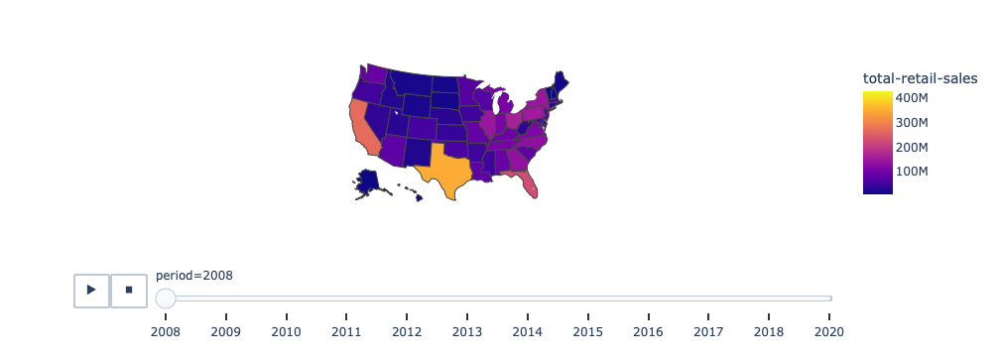

In [44]:
fig1.show()

In [45]:
fig1.write_html("total-retail-sales.html")

### Inference

The plot shows the total retail sales in various states over the years. This value has been increasing over the years

In [46]:
fig1 = px.choropleth(summary[summary["stateID"]!="US"].sort_values(["period"]),
                    locations='stateID',
                    color='net-generation',
                    hover_name='stateDescription',
                    animation_frame='period',
                    locationmode='USA-states',
                    labels={'revenue':'revenue'},
                    range_color=(min(summary["net-generation"]), max(summary[summary["stateID"]!="US"]["net-generation"])),
                    scope='usa')

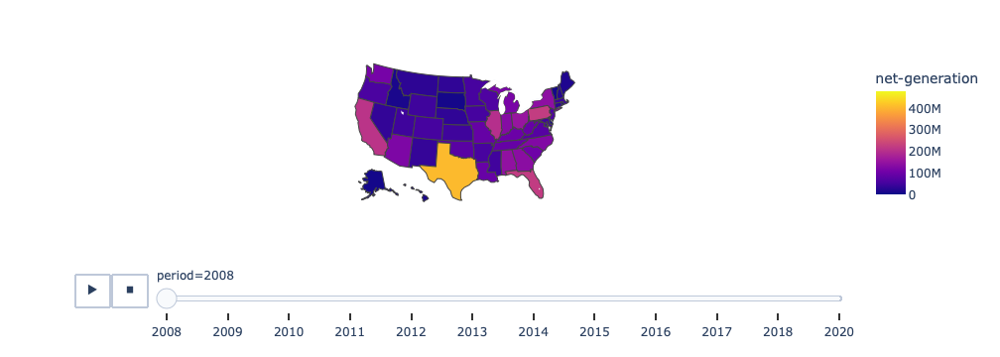

In [47]:
fig1.show()

In [48]:
fig1.write_html("net-generation.html")

### Inference

The plot shows the net generation in various states over the years. This value has been increasing over the years

In [49]:
summary["self_sufficiency_index"]=(summary["net-generation"]/summary["total-retail-sales"])

In [50]:
fig1 = px.choropleth(summary[summary["stateID"]!="US"].sort_values(["period"]),
                    locations='stateID',
                    color="self_sufficiency_index",
                    hover_name='stateDescription',
                    animation_frame='period',
                    locationmode='USA-states',
                    labels={'revenue':'revenue'},
                    range_color=(min(summary["self_sufficiency_index"]), max(summary[summary["stateID"]!="US"]["self_sufficiency_index"])),
                    scope='usa')

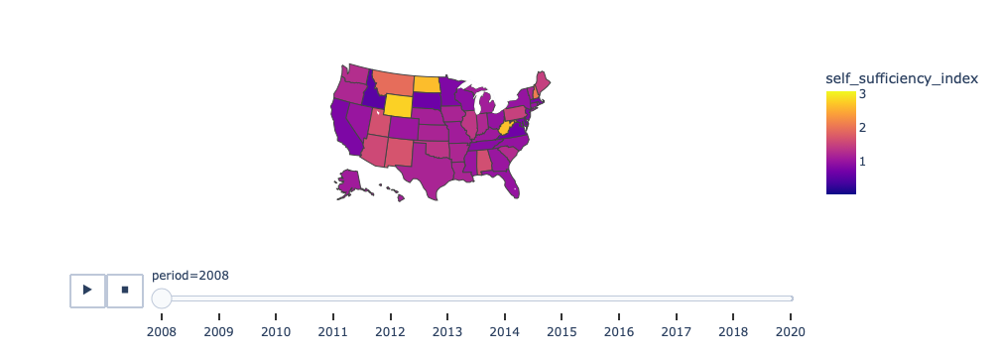

In [51]:
fig1.show()

In [52]:
fig1.write_html("Self_Sufficiency_Index.html")

### Inference

This plot shows the self sufficiency index which is a measure of energy independence of each state. A self sufficiency index of around 1 indicates that a state consumes what it produces and could be self sufficient. Many states fall under this category. 

### Self Sufficiency Index Ranking (2020, Statewise)

In [53]:
# Most Self Suffficient to Least Self Sufficient 
summary[summary['period']==2020].sort_values(['self_sufficiency_index'],ascending=False)[["stateDescription","self_sufficiency_index"]].reset_index(drop=True)

,stateDescription,self_sufficiency_index
0,Wyoming,2.740261
1,North Dakota,1.932974
2,West Virginia,1.766445
3,Alabama,1.649280
4,Pennsylvania,1.647165
5,Montana,1.601276
6,New Hampshire,1.529016
7,Connecticut,1.519181
8,Mississippi,1.432420
9,New Mexico,1.375282


In [54]:
# Least Self Suffficient to Most Self Sufficient 
summary[summary['period']==2020].sort_values(['self_sufficiency_index'])[["stateDescription","self_sufficiency_index"]].reset_index(drop=True)

,stateDescription,self_sufficiency_index
0,District of Columbia,0.020551
1,Massachusetts,0.364215
2,Vermont,0.404469
3,Delaware,0.467728
4,Maryland,0.625192
5,Idaho,0.723024
6,California,0.771761
7,Tennessee,0.848029
8,Ohio,0.848386
9,New Jersey,0.848722


### Loading Data using the eia.loaders.load_dataframe method
We will analyze the 'state-electricity-profiles-emissions-by-state-by-fuel' file and try to find some interesting insights from the data.

In [ ]:
df = eia.loaders.load_dataframe(data='state-electricity-profiles-emissions-by-state-by-fuel')

In [20]:
df.head()

,Unnamed: 0,period,stateid,stateDescription,fuelid,fuelDescription,so2-rate-lbs-mwh,so2-short-tons,nox-rate-lbs-mwh,nox-short-tons,co2-rate-lbs-mwh,co2-thousand-metric-tons,so2-rate-lbs-mwh-units,so2-short-tons-units,nox-rate-lbs-mwh-units,nox-short-tons-units,co2-rate-lbs-mwh-units,co2-thousand-metric-tons-units
0,0.0,2020,AL,Alabama,COL,Coal,NaN,3164,NaN,8315,NaN,21156,pounds per megawatthour,short tons,pounds per megawatthour,short tons,pounds per megawatthour,thousand metric tons
1,1.0,2020,WY,Wyoming,ALL,Total,1.3,27112,1.6,34243,1969.0,37594,pounds per megawatthour,short tons,pounds per megawatthour,short tons,pounds per megawatthour,thousand metric tons
2,2.0,2020,WY,Wyoming,PET,Petroleum,NaN,6,NaN,21,NaN,36,pounds per megawatthour,short tons,pounds per megawatthour,short tons,pounds per megawatthour,thousand metric tons
3,3.0,2020,WY,Wyoming,OTH,Other,NaN,9,NaN,3968,NaN,0,pounds per megawatthour,short tons,pounds per megawatthour,short tons,pounds per megawatthour,thousand metric tons
4,4.0,2020,WY,Wyoming,NG,Natural Gas,NaN,6,NaN,2371,NaN,1072,pounds per megawatthour,short tons,pounds per megawatthour,short tons,pounds per megawatthour,thousand metric tons


In [21]:
df.loc[0]

Unnamed: 0                                            0.0
period                                               2020
stateid                                                AL
stateDescription                                  Alabama
fuelid                                                COL
fuelDescription                                      Coal
so2-rate-lbs-mwh                                      NaN
so2-short-tons                                       3164
nox-rate-lbs-mwh                                      NaN
nox-short-tons                                       8315
co2-rate-lbs-mwh                                      NaN
co2-thousand-metric-tons                            21156
so2-rate-lbs-mwh-units            pounds per megawatthour
so2-short-tons-units                           short tons
nox-rate-lbs-mwh-units            pounds per megawatthour
nox-short-tons-units                           short tons
co2-rate-lbs-mwh-units            pounds per megawatthour
co2-thousand-m

In [22]:
df['period'].unique()

array(['2020', '2018', '2017', '2016', '2015', '2014', '2013', '2012',
       '2011', '2010', '2009', '2008', '2007', '2006', '2005', '2004',
       '2003', '2002', '2001', '2000', 'period', '1999', '1998', '1997',
       '1996', '1995', '1994', '1993', '1992', '1991', '1990'],
      dtype=object)

In [24]:
df['stateid'].unique()

array(['AL', 'WY', 'WV', 'WI', 'UT', 'US', 'TX', 'WA', 'VT', 'VA', 'TN',
       'NM', 'RI', 'PA', 'OR', 'OK', 'SD', 'SC', 'OH', 'NY', 'NV', 'MI',
       'ME', 'ND', 'NC', 'MT', 'MS', 'NJ', 'NH', 'NE', 'MO', 'MN', 'MD',
       'HI', 'GA', 'KY', 'KS', 'IN', 'IL', 'MA', 'LA', 'ID', 'IA', 'AK',
       'CT', 'CO', 'CA', 'AZ', 'FL', 'DE', 'DC', 'AR', 'stateid'],
      dtype=object)

In [25]:
len(df['stateid'].unique())

53

In [26]:
df['stateDescription'].unique()

array(['Alabama', 'Wyoming', 'West Virginia', 'Wisconsin', 'Utah',
       'United States', 'Texas', 'Washington', 'Vermont', 'Virginia',
       'Tennessee', 'New Mexico', 'Rhode Island', 'Pennsylvania',
       'Oregon', 'Oklahoma', 'South Dakota', 'South Carolina', 'Ohio',
       'New York', 'Nevada', 'Michigan', 'Maine', 'North Dakota',
       'North Carolina', 'Montana', 'Mississippi', 'New Jersey',
       'New Hampshire', 'Nebraska', 'Missouri', 'Minnesota', 'Maryland',
       'Hawaii', 'Georgia', 'Kentucky', 'Kansas', 'Indiana', 'Illinois',
       'Massachusetts', 'Louisiana', 'Idaho', 'Iowa', 'Alaska',
       'Connecticut', 'Colorado', 'California', 'Arizona', 'Florida',
       'Delaware', 'District of Columbia', 'Arkansas', 'stateDescription'],
      dtype=object)

In [27]:
df['fuelDescription'].unique()

array(['Coal', 'Total', 'Petroleum', 'Other', 'Natural Gas',
       'fuelDescription'], dtype=object)

### Let's study the SO2, NOX and CO2 emissions for the fuel : Total.
### We will analyze the data for each state from the year 1990 to 2020.

In [28]:
emissions_per_state = {}
for entry in df.values:
    if entry[1] == 2020 and entry[5] == 'Total':
        emissions_per_state[entry[2]] = (entry[7], entry[9], entry[11])

In [29]:
emissions_per_state

{}

In [30]:
df.values[0]

array([0.0, '2020', 'AL', 'Alabama', 'COL', 'Coal', nan, '3164', nan,
       '8315', nan, '21156', 'pounds per megawatthour', 'short tons',
       'pounds per megawatthour', 'short tons', 'pounds per megawatthour',
       'thousand metric tons'], dtype=object)

In [31]:
df.keys

<bound method NDFrame.keys of       Unnamed: 0 period stateid stateDescription fuelid fuelDescription  \
0            0.0   2020      AL          Alabama    COL            Coal   
1            1.0   2020      WY          Wyoming    ALL           Total   
2            2.0   2020      WY          Wyoming    PET       Petroleum   
3            3.0   2020      WY          Wyoming    OTH           Other   
4            4.0   2020      WY          Wyoming     NG     Natural Gas   
...          ...    ...     ...              ...    ...             ...   
7560      2559.0   1990      WY          Wyoming    COL            Coal   
7561      2560.0   1990      WY          Wyoming     NG     Natural Gas   
7562      2561.0   1990      WY          Wyoming    OTH           Other   
7563      2562.0   1990      WY          Wyoming    PET       Petroleum   
7564      2563.0   1990      WY          Wyoming    ALL           Total   

     so2-rate-lbs-mwh so2-short-tons nox-rate-lbs-mwh nox-short-tons 

### SO2 Emissions

In [37]:
so2 = {}
for year in df['period'].unique():
    if year != 'period':
        d = {}
        for i in df.values:
            if i[1] == year and i[5] == 'Total':
                d[i[2]] = i[6]
        y = int(year)
        so2[y] = d

In [43]:
so2[1990]

{'AR': '4.4',
 'CT': '3.3',
 'DC': '14.1',
 'DE': '22.5',
 'FL': '10.6',
 'AZ': '4.0',
 'CA': '1.1',
 'CO': '6.3',
 'AK': '7.4',
 'AL': '14.0',
 'GA': '18.2',
 'IA': '13.4',
 'ID': '2.0',
 'IL': '14.5',
 'LA': '3.2',
 'MA': '11.7',
 'MD': '17.9',
 'IN': '27.8',
 'KS': '5.1',
 'KY': '24.4',
 'HI': '8.0',
 'MN': '5.2',
 'MO': '26.9',
 'ND': '10.9',
 'NE': '4.8',
 'NH': '10.7',
 'NJ': '3.9',
 'MS': '10.5',
 'MT': '1.5',
 'NC': '9.4',
 'ME': '7.3',
 'MI': '8.4',
 'NV': '5.5',
 'NY': '6.8',
 'SC': '5.6',
 'SD': '9.7',
 'OH': '34.7',
 'OK': '4.8',
 'OR': '0.4',
 'PA': '15.6',
 'RI': '3.3',
 'NM': '4.1',
 'TN': '22.1',
 'VA': '9.1',
 'VT': '0.0',
 'WA': '1.5',
 'TX': '4.5',
 'US': '11.2',
 'UT': '1.9',
 'WI': '14.7',
 'WV': '24.3',
 'WY': '5.5'}

In [40]:
layout = dict(geo = {'scope':'usa'})

In [45]:
years

['1990',
 '1991',
 '1992',
 '1993',
 '1994',
 '1995',
 '1996',
 '1997',
 '1998',
 '1999',
 '2000',
 '2001',
 '2002',
 '2003',
 '2004',
 '2005',
 '2006',
 '2007',
 '2008',
 '2009',
 '2010',
 '2011',
 '2012',
 '2013',
 '2014',
 '2015',
 '2016',
 '2017',
 '2018',
 '2020']

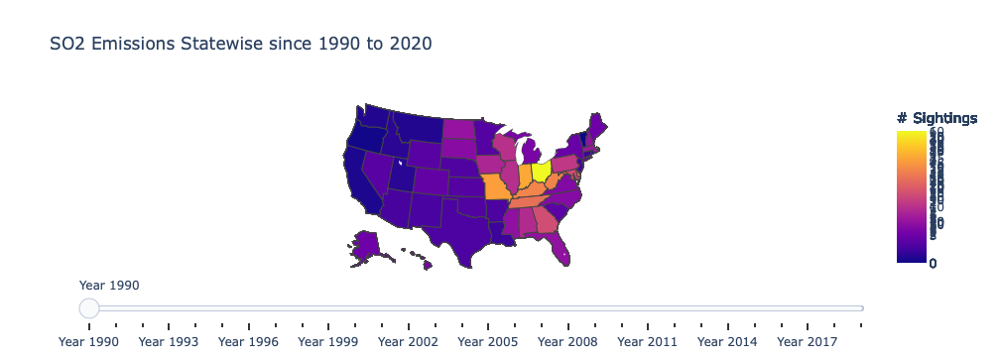

In [71]:
years = so2.keys()
data_slider = []
for year in years:

    data_each_yr = dict(
                        type='choropleth',
                        locations = list(so2[year].keys()),
                        z=list(so2[year].values()),
                        locationmode='USA-states',
                        # colorscale = scl,
                        colorbar= {'title':'# Sightings'}
                        )

    data_slider.append(data_each_yr)

steps = []
for i in range(len(data_slider)):
    step = dict(method='restyle',
                args=['visible', [False] * len(data_slider)],
                label='Year {}'.format(i + 1990))
    step['args'][1][i] = True
    steps.append(step)

sliders = [dict(active=0, pad={"t": 1}, steps=steps)]

layout = dict(title ='SO2 Emissions Statewise since 1990 to 2020', geo=dict(scope='usa',
                       projection={'type': 'albers usa'}), sliders=sliders)

fig1 = dict(data=data_slider, layout=layout)
po.iplot(fig1)


In [79]:
pg.Figure.write_html(fig1,'SO2_Emmissions.html')

### NOX Emissions

In [65]:
nox = {}
for year in df['period'].unique():
    if year != 'period':
        d = {}
        for i in df.values:
            if i[1] == year and i[5] == 'Total':
                d[i[2]] = i[8]
        y = int(year)
        nox[y] = d

In [66]:
nox[2020]

{'WY': '1.6',
 'WV': '1.1',
 'WI': '0.8',
 'UT': '1.7',
 'US': '0.7',
 'TX': '0.7',
 'WA': '0.2',
 'VT': '1.1',
 'VA': '0.4',
 'TN': '0.3',
 'NM': '0.8',
 'RI': '0.8',
 'PA': '0.4',
 'OR': '0.5',
 'OK': '0.5',
 'SD': '0.2',
 'SC': '0.3',
 'OH': '0.9',
 'NY': '0.4',
 'NV': '0.5',
 'MI': '1.2',
 'ME': '1.1',
 'ND': '1.5',
 'NC': '0.7',
 'MT': '0.9',
 'NJ': '0.3',
 'NH': '0.2',
 'NE': '1.1',
 'MS': '0.5',
 'MO': '1.5',
 'MN': '0.7',
 'MD': '0.3',
 'HI': '3.6',
 'GA': '0.6',
 'KY': '1.0',
 'KS': '0.5',
 'IN': '1.4',
 'IL': '0.3',
 'MA': '0.9',
 'LA': '1.2',
 'ID': '0.5',
 'IA': '0.6',
 'AL': '0.3',
 'AK': '6.9',
 'CT': '0.3',
 'CO': '0.7',
 'CA': '0.8',
 'AZ': '0.5',
 'FL': '0.4',
 'DE': '0.6',
 'DC': '5.7',
 'AR': '0.6'}

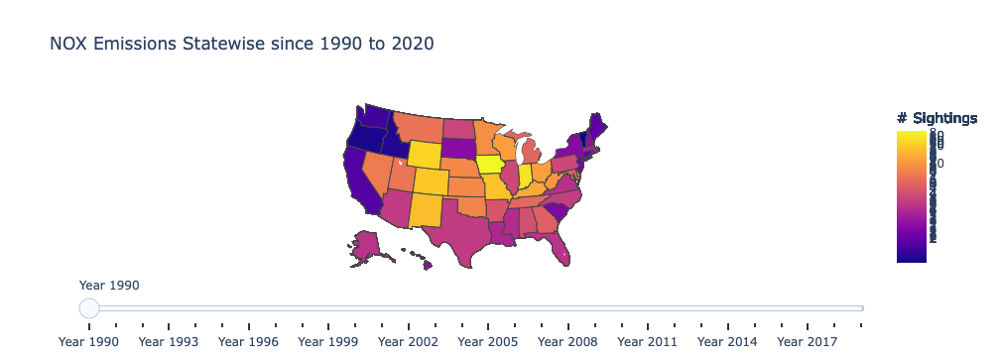

In [72]:
years = nox.keys()

data_slider = []
for year in years:

    data_each_yr = dict(
                        type='choropleth',
                        locations = list(nox[year].keys()),
                        z=list(nox[year].values()),
                        locationmode='USA-states',
                        # colorscale = scl,
                        colorbar= {'title':'# Sightings'})

    data_slider.append(data_each_yr)

steps = []
for i in range(len(data_slider)):
    step = dict(method='restyle',
                args=['visible', [False] * len(data_slider)],
                label='Year {}'.format(i + 1990))
    step['args'][1][i] = True
    steps.append(step)

sliders = [dict(active=0, pad={"t": 1}, steps=steps)]

layout = dict(title ='NOX Emissions Statewise since 1990 to 2020', geo=dict(scope='usa',
                       projection={'type': 'albers usa'}),
              sliders=sliders)

fig2 = dict(data=data_slider, layout=layout)
po.iplot(fig2)

In [80]:
pg.Figure.write_html(fig2,'NOX_Emmissions.html')

### CO2 Emissions

In [68]:
co2 = {}
for year in df['period'].unique():
    if year != 'period':
        d = {}
        for i in df.values:
            if i[1] == year and i[5] == 'Total':
                d[i[2]] = i[10]
        y = int(year)
        co2[y] = d

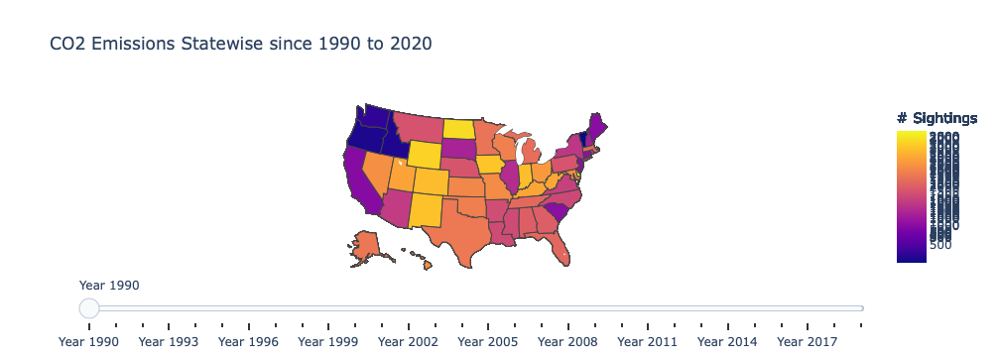

In [73]:

years = co2.keys()
scl = [[0.0, '#ffffff'],[0.2, '#b4a8ce'],[0.4, '#8573a9'],
       [0.6, '#7159a3'],[0.8, '#5732a1'],[1.0, '#2c0579']] # purples

data_slider = []
for year in years:

    data_each_yr = dict(
                        type='choropleth',
                        locations = list(co2[year].keys()),
                        z=list(co2[year].values()),
                        locationmode='USA-states',
                        #colorscale = scl,
                        colorbar= {'title':'# Sightings'})

    data_slider.append(data_each_yr)

steps = []
for i in range(len(data_slider)):
    step = dict(method='restyle',
                args=['visible', [False] * len(data_slider)],
                label='Year {}'.format(i + 1990))
    step['args'][1][i] = True
    steps.append(step)

sliders = [dict(active=0, pad={"t": 1}, steps=steps)]

layout = dict(title ='CO2 Emissions Statewise since 1990 to 2020', geo=dict(scope='usa',
                       projection={'type': 'albers usa'}),
              sliders=sliders)

fig3 = dict(data=data_slider, layout=layout)
po.iplot(fig3)

In [81]:
pg.Figure.write_html(fig3,'CO2_Emmissions.html')

In [26]:
df['so2-short-tons'[[]]].isnull().sum()

0

In [27]:
df['nox-short-tons'].isnull().sum()

0

In [28]:
a = np.array(df['so2-short-tons'])
b = np.array(df['nox-short-tons'])
c = np.array(df['co2-thousand-metric-tons'])

In [29]:
print(np.corrcoef(a,b))
print(np.corrcoef(a,c))
print(np.corrcoef(b,c))

[[1.         0.92468142]
 [0.92468142 1.        ]]
[[1.         0.78789815]
 [0.78789815 1.        ]]
[[1.         0.81273815]
 [0.81273815 1.        ]]


In [30]:
df_ = df.groupby(['fuelDescription'])

In [31]:
a = np.array(df_['so2-short-tons'])
b = np.array(df_['nox-short-tons'])
c = np.array(df_['co2-thousand-metric-tons'])

In [32]:
a_coal = a[0][1]
a_coal

1        474527
6        591936
15       100454
20       554692
25       609416
         ...   
4953    1022707
4958     664657
4964    1193241
4967    1485827
4972      91350
Name: so2-short-tons, Length: 995, dtype: int64

In [33]:
b_coal = b[0][1]
b_coal

1       120703
6       214362
15       38719
20      207984
25      224054
         ...  
4953    242740
4958    114016
4964    375194
4967    580934
4972     54169
Name: nox-short-tons, Length: 995, dtype: int64

In [34]:
c_coal = c[0][1]
c_coal

1        76742
6        69417
15       40819
20       66054
25       71267
         ...  
4953    127713
4958    110910
4964    122750
4967    122506
4972     65477
Name: co2-thousand-metric-tons, Length: 995, dtype: int64

In [35]:
print(np.corrcoef(a_coal,b_coal))
print(np.corrcoef(a_coal,c_coal))
print(np.corrcoef(b_coal,c_coal))

[[1.         0.91696327]
 [0.91696327 1.        ]]
[[1.         0.79698079]
 [0.79698079 1.        ]]
[[1.         0.75232828]
 [0.75232828 1.        ]]


In [36]:
for i,fuel in enumerate(df['fuelDescription'].unique()):
    a_ = a[i][1]
    b_ = b[i][1]
    c_ = c[i][1]
    
    print(a[i][0])
    print(np.corrcoef(a_,b_))
    print(np.corrcoef(a_,c_))
    print(np.corrcoef(b_,c_))

Coal
[[1.         0.91696327]
 [0.91696327 1.        ]]
[[1.         0.79698079]
 [0.79698079 1.        ]]
[[1.         0.75232828]
 [0.75232828 1.        ]]
Natural Gas
[[1.         0.64178898]
 [0.64178898 1.        ]]
[[1.         0.84969985]
 [0.84969985 1.        ]]
[[1.         0.81143666]
 [0.81143666 1.        ]]
Other
[[1.         0.51395626]
 [0.51395626 1.        ]]
[[1.         0.13285878]
 [0.13285878 1.        ]]
[[1.         0.64581142]
 [0.64581142 1.        ]]
Petroleum
[[1.         0.90382125]
 [0.90382125 1.        ]]
[[1.        0.9044743]
 [0.9044743 1.       ]]
[[1.        0.9110826]
 [0.9110826 1.       ]]
Total
[[1.         0.91319382]
 [0.91319382 1.        ]]
[[1.         0.73113509]
 [0.73113509 1.        ]]
[[1.         0.73141307]
 [0.73141307 1.        ]]


## Section 3: Pandas Profiling - Per Dataset Data Analysis

### DataFrames available:

- electric-power-operational-data
- facility-fuel
- operating-generator-capacity
- retail-sales
- rto-daily-fuel-type-data
- rto-daily-interchange-data
- rto-daily-region-data
- rto-daily-region-sub-ba-data
- rto-fuel-type-data
- rto-interchange-data
- rto-region-data
- rto-region-sub-ba-data
- state-electricity-profiles-capability
- state-electricity-profiles-emissions-by-state-by-fuel
- state-electricity-profiles-meters
- state-electricity-profiles-net-metering
- state-electricity-profiles-source-disposition
- state-electricity-profiles-summary

### Pandas Profiling Reports

In [29]:
import eia
from eia.loaders import load_dataframe
from pandas_profiling import ProfileReport

In [28]:
mapping = {
    "electric-power-operational-data": "csv/electric-power-operational-data_data.csv",
    "facility-fuel": "csv/facility-fuel_data.csv",
    "operating-generator-capacity": "csv/operating-generator-capacity_data.csv",
    "retail-sales": "csv/retail-sales_data.csv",
    "rto-daily-fuel-type-data": "rto/csv/daily-fuel-type-data_data.csv",
    "rto-daily-interchange-data": "rto/csv/daily-interchange-data_data.csv",
    "rto-daily-region-data": "rto/csv/rto-daily-region-data_data.csv",
    "rto-daily-region-sub-ba-data": "rto/csv/daily-region-sub-ba-data_data.csv",
    "rto-fuel-type-data": "rto/csv/fuel-type-data_data.csv",
    "rto-interchange-data": "rto/csv/interchange-data_data.csv",
    "rto-region-data": "rto/csv/region-data_data.csv",
    "rto-region-sub-ba-data": "rto/csv/region-sub-ba-data_data.csv",
    "state-electricity-profiles-capability": "state-electricity-profiles/csv/capability_data.csv",
    "state-electricity-profiles-emissions-by-state-by-fuel": "state-electricity-profiles/csv/emissions-by-state-by-fuel_data.csv",
    "state-electricity-profiles-meters": "state-electricity-profiles/csv/meters_data.csv",
    "state-electricity-profiles-net-metering": "state-electricity-profiles/csv/net-metering_data.csv",
    "state-electricity-profiles-source-disposition": "state-electricity-profiles/csv/source-disposition_data.csv",
    "state-electricity-profiles-summary": "state-electricity-profiles/csv/summary_data.csv",
}

In [31]:
import tqdm

for key in tqdm.tqdm(mapping.keys()):
    df = load_dataframe(key)
    report = ProfileReport(df)
    report.to_file(output_file=f"html_reports/{key}.html")

  0%|                                                                                                  | 0/18 [00:00<?, ?it/s]

/Users/lukewood/data/eia-py/data/csv/electric-power-operational-data_data.csv


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

  6%|█████                                                                                     | 1/18 [01:18<22:20, 78.84s/it]

/Users/lukewood/data/eia-py/data/csv/facility-fuel_data.csv


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

 11%|██████████                                                                                | 2/18 [01:48<13:19, 49.96s/it]

/Users/lukewood/data/eia-py/data/csv/operating-generator-capacity_data.csv


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

/Users/lukewood/Library/Python/3.9/lib/python/site-packages/pandas_profiling/model/correlations.py:67: UserWarning: There was an attempt to calculate the auto correlation, but this failed.
To hide this warning, disable the calculation
(using `df.profile_report(correlations={"auto": {"calculate": False}})`
If this is problematic for your use case, please report this as an issue:
https://github.com/ydataai/pandas-profiling/issues
(include the error message: 'No data; `observed` has size 0.')
  warnings.warn(


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

 17%|███████████████                                                                           | 3/18 [02:22<10:41, 42.79s/it]

/Users/lukewood/data/eia-py/data/csv/retail-sales_data.csv


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

 22%|████████████████████                                                                      | 4/18 [02:36<07:19, 31.39s/it]

/Users/lukewood/data/eia-py/data/rto/csv/daily-fuel-type-data_data.csv


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

 28%|█████████████████████████                                                                 | 5/18 [02:45<05:00, 23.08s/it]

/Users/lukewood/data/eia-py/data/rto/csv/daily-interchange-data_data.csv


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

 33%|██████████████████████████████                                                            | 6/18 [02:54<03:40, 18.40s/it]

/Users/lukewood/data/eia-py/data/rto/csv/rto-daily-region-data_data.csv
Scraping route schemas...



100%|███████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:45<00:00,  7.62s/it]


Scraping rto data...



100%|██████████████████████████████████████████████████████████████████████████████████████████| 8/8 [16:34<00:00, 124.35s/it]


Scraping state-electricity-profiles data...



 33%|█████████████████████████████▋                                                           | 6/18 [20:40<41:21, 206.79s/it]


FileNotFoundError: [Errno 2] No such file or directory: '/Users/lukewood/data/eia-py/data/rto/csv/rto-daily-region-data_data.csv'

## Section 4: RTO Data Analysis

In [ ]:
import matplotlib.pyplot as plt

### Daily region data (10/13/22 - 11/18/22)

In [5]:
df = pd.read_csv('./data/data/rto/csv/daily-region-data_data.csv')

In [6]:
df.head(10)

,Unnamed: 0,period,respondent,respondent-name,type,type-name,timezone,timezone-description,value,value-units
0,0.0,2022-11-18,PGE,Portland General Electric Company,DF,Day-ahead demand forecast,Pacific,Pacific,68859,megawatthours
1,1.0,2022-11-18,CHPD,Public Utility District No. 1 of Chelan County,DF,Day-ahead demand forecast,Eastern,Eastern,7660,megawatthours
2,2.0,2022-11-18,WAUW,Western Area Power Administration - Upper Grea...,DF,Day-ahead demand forecast,Arizona,Arizona,2753,megawatthours
3,3.0,2022-11-18,TEPC,Tucson Electric Power,DF,Day-ahead demand forecast,Eastern,Eastern,35751,megawatthours
4,4.0,2022-11-18,TPWR,"City of Tacoma, Department of Public Utilities...",DF,Day-ahead demand forecast,Eastern,Eastern,16790,megawatthours
5,5.0,2022-11-18,TIDC,Turlock Irrigation District,DF,Day-ahead demand forecast,Mountain,Mountain,7030,megawatthours
6,6.0,2022-11-18,WACM,Western Area Power Administration - Rocky Moun...,DF,Day-ahead demand forecast,Central,Central,82330,megawatthours
7,7.0,2022-11-18,SW,Southwest,DF,Day-ahead demand forecast,Mountain,Mountain,192616,megawatthours
8,8.0,2022-11-18,EPE,El Paso Electric Company,DF,Day-ahead demand forecast,Arizona,Arizona,20325,megawatthours
9,9.0,2022-11-18,TVA,Tennessee Valley Authority,DF,Day-ahead demand forecast,Central,Central,517752,megawatthours


In [24]:
df_timezone = pd.DataFrame(df['timezone'].value_counts())
df_timezone = df_timezone.drop(['timezone'])
sum1 = [0] * 5
for idx, row in df.iterrows():
    if row['timezone'] == 'Eastern':
        sum1[0] += int(row['value'])
    elif row['timezone'] == 'Central':
        sum1[1] += int(row['value'])
    elif row['timezone'] == 'Mountain':
        sum1[2] += int(row['value'])
    elif row['timezone'] == 'Arizona':
        sum1[3] += int(row['value'])
    elif row['timezone'] == 'Pacific':
        sum1[4] += int(row['value'])
df_timezone['total value'] = sum1

In [25]:
df_timezone

,timezone,total value
Eastern,10351,3102238397
Central,10075,2974680494
Mountain,9934,2931843834
Arizona,9883,2867712038
Pacific,9757,2864980126


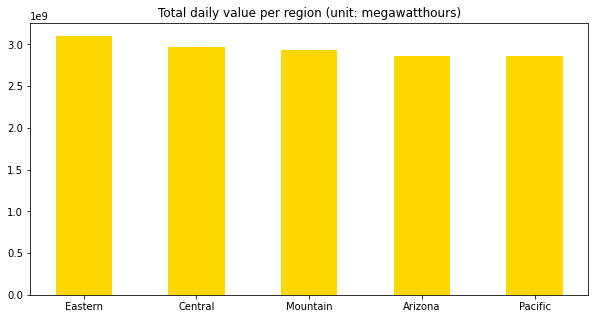

In [89]:
plt.rcParams["figure.figsize"] = (10, 5)
plt.bar(['Eastern', 'Central', 'Mountain', 'Arizona', 'Pacific'], df_timezone['total value'], width=0.5, color='gold')
plt.title('Total daily value per region (unit: megawatthours)')
plt.show()

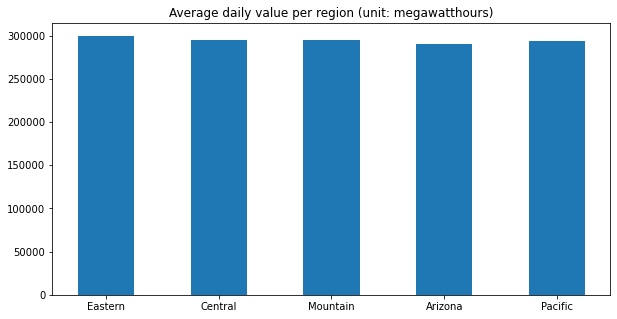

In [90]:
plt.bar(['Eastern', 'Central', 'Mountain', 'Arizona', 'Pacific'], df_timezone['total value'] / df_timezone['timezone'], width=0.5)
plt.title('Average daily value per region (unit: megawatthours)')
plt.show()

In [97]:
res = dict(df['respondent'].value_counts())
for key in res:
    res[key] = 0
for idx, row in df.iterrows():
    try:
        res[row['respondent']] += int(row['value'])
    except ValueError:
        continue
res = dict(sorted(res.items(), key=lambda item: item[1], reverse=True))
del res['respondent']

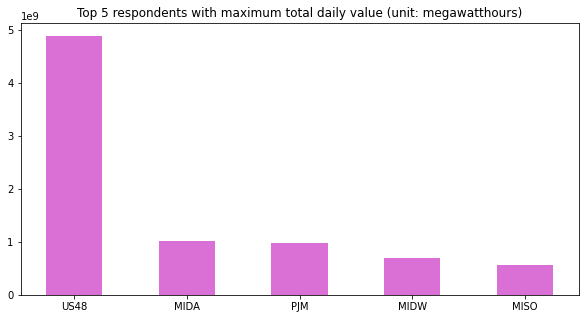

In [98]:
top5 = []
top5_value = []
for key in res:
    if len(top5) < 5:
        top5.append(key)
        top5_value.append(res[key])
plt.bar(top5, top5_value, width=0.5, color='orchid')
plt.title('Top 5 respondents with maximum total daily value (unit: megawatthours)')
plt.show()

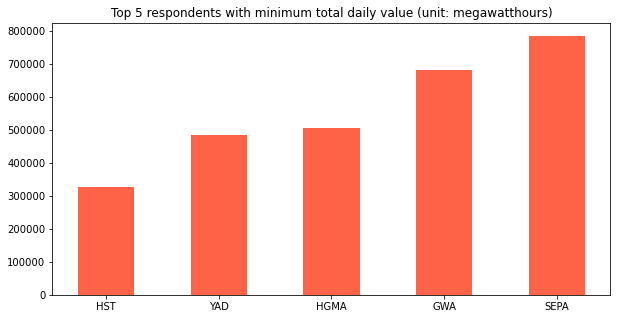

In [99]:
res = dict(sorted(res.items(), key=lambda item: item[1]))
top5 = []
top5_value = []
for key in res:
    if len(top5) < 5:
        top5.append(key)
        top5_value.append(res[key])
plt.bar(top5, top5_value, width=0.5, color='tomato')
plt.title('Top 5 respondents with minimum total daily value (unit: megawatthours)')
plt.show()

### Daily fuel type data (10/22/22 - 11/17/22)

In [100]:
df = pd.read_csv('./data/data/rto/csv/daily-fuel-type-data_data.csv')

In [101]:
df.head(10)

,Unnamed: 0,period,respondent,respondent-name,fueltype,type-name,timezone,timezone-description,value,value-units
0,0.0,2022-11-17,BANC,Balancing Authority of Northern California,WAT,Hydro,Pacific,Pacific,3339,megawatthours
1,1.0,2022-11-17,PSCO,Public Service Company of Colorado,OIL,Petroleum,Eastern,Eastern,-5,megawatthours
2,2.0,2022-11-17,HGMA,"New Harquahala Generating Company, LLC",NG,Natural gas,Arizona,Arizona,-35,megawatthours
3,3.0,2022-11-17,NW,Northwest,WND,Wind,Arizona,Arizona,123276,megawatthours
4,4.0,2022-11-17,NW,Northwest,WND,Wind,Mountain,Mountain,123276,megawatthours
5,5.0,2022-11-17,NEVP,Nevada Power Company,SUN,Solar,Eastern,Eastern,13766,megawatthours
6,6.0,2022-11-17,SWPP,Southwest Power Pool,COL,Coal,Eastern,Eastern,221217,megawatthours
7,7.0,2022-11-17,DUK,Duke Energy Carolinas,COL,Coal,Eastern,Eastern,77825,megawatthours
8,8.0,2022-11-17,PSEI,"Puget Sound Energy, Inc.",OTH,Other,Eastern,Eastern,664,megawatthours
9,9.0,2022-11-17,IPCO,Idaho Power Company,OIL,Petroleum,Mountain,Mountain,0,megawatthours


In [104]:
tn = dict(df['type-name'].value_counts())
for key in tn:
    tn[key] = 0
for idx, row in df.iterrows():
    try:
        tn[row['type-name']] += int(row['value'])
    except ValueError:
        continue
tn = dict(sorted(tn.items(), key=lambda item: item[1], reverse=True))
del tn['type-name']

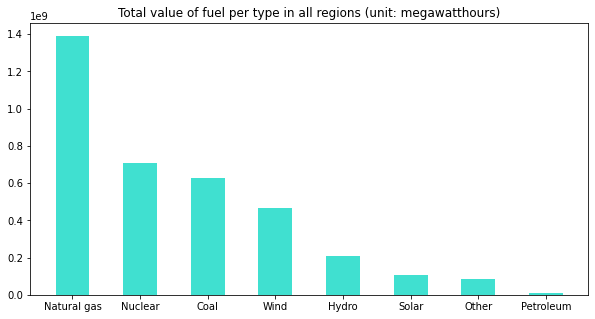

In [113]:
plt.bar(tn.keys(), tn.values(), color='turquoise', width=0.5)
plt.title('Total value of fuel per type in all regions (unit: megawatthours)')
plt.show()

In [116]:
df_e = df.loc[df['timezone'] == 'Eastern']
df_e.head()

,Unnamed: 0,period,respondent,respondent-name,fueltype,type-name,timezone,timezone-description,value,value-units
1,1.0,2022-11-17,PSCO,Public Service Company of Colorado,OIL,Petroleum,Eastern,Eastern,-5,megawatthours
5,5.0,2022-11-17,NEVP,Nevada Power Company,SUN,Solar,Eastern,Eastern,13766,megawatthours
6,6.0,2022-11-17,SWPP,Southwest Power Pool,COL,Coal,Eastern,Eastern,221217,megawatthours
7,7.0,2022-11-17,DUK,Duke Energy Carolinas,COL,Coal,Eastern,Eastern,77825,megawatthours
8,8.0,2022-11-17,PSEI,"Puget Sound Energy, Inc.",OTH,Other,Eastern,Eastern,664,megawatthours


In [118]:
tne = dict(df_e['type-name'].value_counts())
for key in tne:
    tne[key] = 0
for idx, row in df_e.iterrows():
    try:
        tne[row['type-name']] += int(row['value'])
    except ValueError:
        continue
tne = dict(sorted(tne.items(), key=lambda item: item[1], reverse=True))

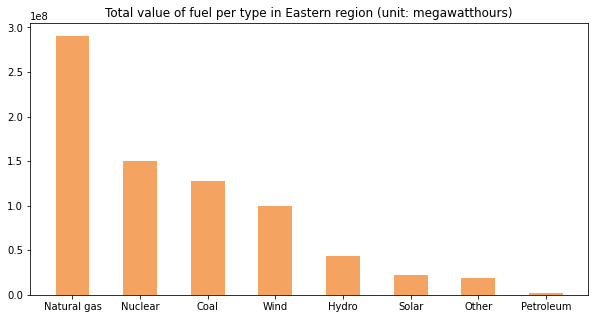

In [121]:
plt.bar(tne.keys(), tne.values(), color='sandybrown', width=0.5)
plt.title('Total value of fuel per type in Eastern region (unit: megawatthours)')
plt.show()

In [122]:
df_c = df.loc[df['timezone'] == 'Central']
df_c.head()

,Unnamed: 0,period,respondent,respondent-name,fueltype,type-name,timezone,timezone-description,value,value-units
22,22.0,2022-11-17,SW,Southwest,WAT,Hydro,Central,Central,10639,megawatthours
32,32.0,2022-11-17,WWA,"NaturEner Wind Watch, LLC",WND,Wind,Central,Central,3051,megawatthours
35,35.0,2022-11-17,PSCO,Public Service Company of Colorado,WAT,Hydro,Central,Central,460,megawatthours
36,36.0,2022-11-17,PACW,PacifiCorp West,WND,Wind,Central,Central,68,megawatthours
40,40.0,2022-11-17,TVA,Tennessee Valley Authority,NUC,Nuclear,Central,Central,177285,megawatthours


In [123]:
tnc = dict(df_c['type-name'].value_counts())
for key in tnc:
    tnc[key] = 0
for idx, row in df_c.iterrows():
    try:
        tnc[row['type-name']] += int(row['value'])
    except ValueError:
        continue
tnc = dict(sorted(tnc.items(), key=lambda item: item[1], reverse=True))

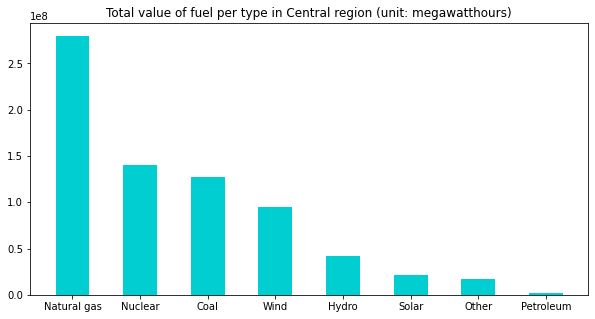

In [124]:
plt.bar(tnc.keys(), tnc.values(), color='darkturquoise', width=0.5)
plt.title('Total value of fuel per type in Central region (unit: megawatthours)')
plt.show()

In [125]:
df_m = df.loc[df['timezone'] == 'Mountain']
df_m.head()

,Unnamed: 0,period,respondent,respondent-name,fueltype,type-name,timezone,timezone-description,value,value-units
4,4.0,2022-11-17,NW,Northwest,WND,Wind,Mountain,Mountain,123276,megawatthours
9,9.0,2022-11-17,IPCO,Idaho Power Company,OIL,Petroleum,Mountain,Mountain,0,megawatthours
10,10.0,2022-11-17,AVA,Avista Corporation,NG,Natural gas,Mountain,Mountain,6976,megawatthours
13,13.0,2022-11-17,CISO,California Independent System Operator,OTH,Other,Mountain,Mountain,9954,megawatthours
15,15.0,2022-11-17,SW,Southwest,OTH,Other,Mountain,Mountain,926,megawatthours


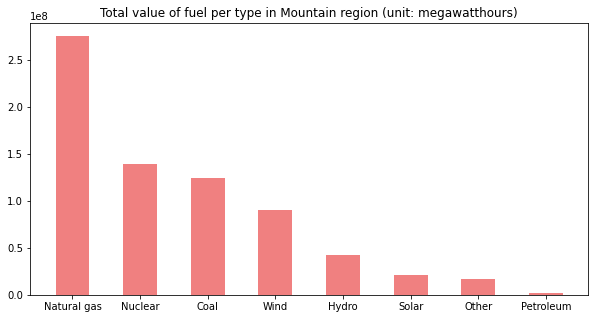

In [126]:
tnm = dict(df_m['type-name'].value_counts())
for key in tnm:
    tnm[key] = 0
for idx, row in df_m.iterrows():
    try:
        tnm[row['type-name']] += int(row['value'])
    except ValueError:
        continue
tnm = dict(sorted(tnm.items(), key=lambda item: item[1], reverse=True))
plt.bar(tnm.keys(), tnm.values(), color='lightcoral', width=0.5)
plt.title('Total value of fuel per type in Mountain region (unit: megawatthours)')
plt.show()

In [128]:
df_a = df.loc[df['timezone'] == 'Arizona']
df_a.head()

,Unnamed: 0,period,respondent,respondent-name,fueltype,type-name,timezone,timezone-description,value,value-units
2,2.0,2022-11-17,HGMA,"New Harquahala Generating Company, LLC",NG,Natural gas,Arizona,Arizona,-35,megawatthours
3,3.0,2022-11-17,NW,Northwest,WND,Wind,Arizona,Arizona,123276,megawatthours
11,11.0,2022-11-17,PACE,PacifiCorp East,OTH,Other,Arizona,Arizona,3232,megawatthours
19,19.0,2022-11-17,TEPC,Tucson Electric Power,SUN,Solar,Arizona,Arizona,2023,megawatthours
24,24.0,2022-11-17,WACM,Western Area Power Administration - Rocky Moun...,WND,Wind,Arizona,Arizona,16182,megawatthours


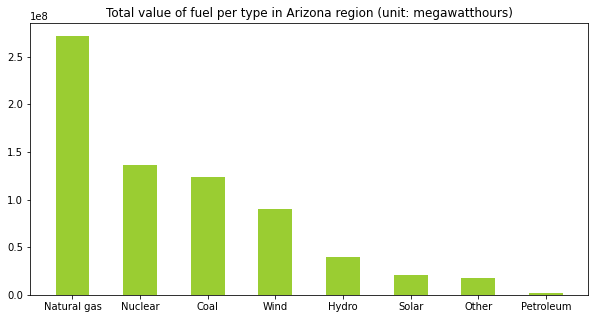

In [130]:
tna = dict(df_a['type-name'].value_counts())
for key in tna:
    tna[key] = 0
for idx, row in df_a.iterrows():
    try:
        tna[row['type-name']] += int(row['value'])
    except ValueError:
        continue
tna = dict(sorted(tna.items(), key=lambda item: item[1], reverse=True))
plt.bar(tna.keys(), tna.values(), color='yellowgreen', width=0.5)
plt.title('Total value of fuel per type in Arizona region (unit: megawatthours)')
plt.show()

In [131]:
df_p = df.loc[df['timezone'] == 'Pacific']
df_p.head()

,Unnamed: 0,period,respondent,respondent-name,fueltype,type-name,timezone,timezone-description,value,value-units
0,0.0,2022-11-17,BANC,Balancing Authority of Northern California,WAT,Hydro,Pacific,Pacific,3339,megawatthours
16,16.0,2022-11-17,IPCO,Idaho Power Company,SUN,Solar,Pacific,Pacific,1003,megawatthours
41,41.0,2022-11-17,IID,Imperial Irrigation District,OTH,Other,Pacific,Pacific,8567,megawatthours
73,73.0,2022-11-17,GRID,"Gridforce Energy Management, LLC",WND,Wind,Pacific,Pacific,8742,megawatthours
83,83.0,2022-11-17,CAL,California,COL,Coal,Pacific,Pacific,9392,megawatthours


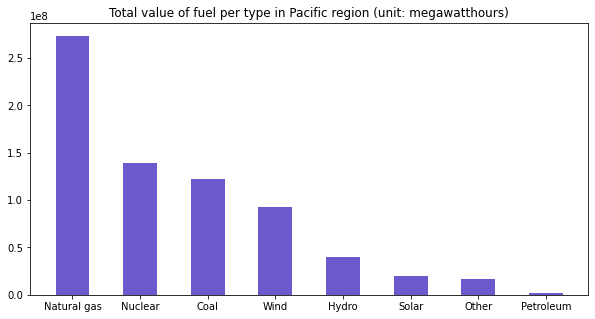

In [133]:
tnp = dict(df_p['type-name'].value_counts())
for key in tnp:
    tnp[key] = 0
for idx, row in df_p.iterrows():
    try:
        tnp[row['type-name']] += int(row['value'])
    except ValueError:
        continue
tnp = dict(sorted(tnp.items(), key=lambda item: item[1], reverse=True))
plt.bar(tnp.keys(), tnp.values(), color='slateblue', width=0.5)
plt.title('Total value of fuel per type in Pacific region (unit: megawatthours)')
plt.show()

 - 'rto - daily-interchange-data'
 - 'rto - daily-region-sub-ba-data'

In [1]:
import eia
import pandas as pd
import matplotlib.pyplot as plt

### Daily interchange data (10/17/22 - 11/16/22)

In [2]:
df = pd.read_csv('./data/data/rto/csv/daily-interchange-data_data.csv')

In [3]:
df.head(10)

,Unnamed: 0,period,fromba,fromba-name,toba,toba-name,timezone,value,value-units
0,0.0,2022-11-16,BPAT,Bonneville Power Administration,CISO,California Independent System Operator,Arizona,9729,megawatthours
1,1.0,2022-11-16,CISO,California Independent System Operator,WALC,Western Area Power Administration - Desert Sou...,Mountain,-2226,megawatthours
2,2.0,2022-11-16,NY,New York,NE,New England,Eastern,-6362,megawatthours
3,3.0,2022-11-16,PNM,Public Service Company of New Mexico,EPE,El Paso Electric Company,Arizona,7607,megawatthours
4,4.0,2022-11-16,SWPP,Southwest Power Pool,SPA,Southwestern Power Administration,Eastern,-769,megawatthours
5,5.0,2022-11-16,BPAT,Bonneville Power Administration,BCHA,British Columbia Hydro and Power Authority,Eastern,-4707,megawatthours
6,6.0,2022-11-16,PACW,PacifiCorp West,AVA,Avista Corporation,Mountain,-1183,megawatthours
7,7.0,2022-11-16,CAL,California,NW,Northwest,Eastern,-18515,megawatthours
8,8.0,2022-11-16,PACW,PacifiCorp West,PGE,Portland General Electric Company,Pacific,-2934,megawatthours
9,9.0,2022-11-16,WALC,Western Area Power Administration - Desert Sou...,GRIF,"Griffith Energy, LLC",Central,-10733,megawatthours


In [4]:
df_timezone = pd.DataFrame(df['timezone'].value_counts())
df_timezone = df_timezone.drop(['timezone'])
sum1 = [0] * 5
for idx, row in df.iterrows():
    if row['timezone'] == 'Eastern':
        sum1[0] += int(row['value'])
    elif row['timezone'] == 'Central':
        sum1[1] += int(row['value'])
    elif row['timezone'] == 'Mountain':
        sum1[2] += int(row['value'])
    elif row['timezone'] == 'Arizona':
        sum1[3] += int(row['value'])
    elif row['timezone'] == 'Pacific':
        sum1[4] += int(row['value'])
df_timezone['total value'] = sum1

In [5]:
df_timezone

,timezone,total value
Pacific,10424,-6143541
Mountain,10079,-5804234
Arizona,9990,-4704984
Central,9900,-5240251
Eastern,9607,-4202789


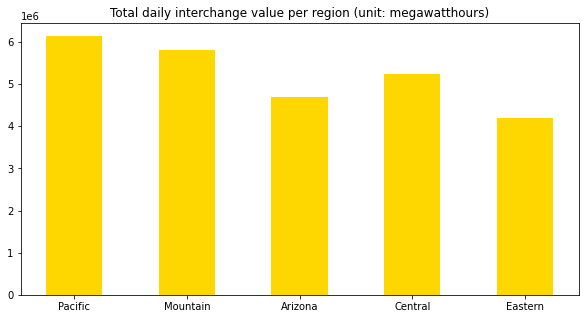

In [10]:
plt.rcParams["figure.figsize"] = (10, 5)
plt.bar(['Pacific', 'Mountain', 'Arizona', 'Central', 'Eastern'], -df_timezone['total value'], width=0.5, color='gold')
plt.title('Total daily interchange value per region (unit: megawatthours)')
plt.show()

In [20]:
fromba = dict(df['fromba'].value_counts())
for key in fromba:
    fromba[key] = 0
for idx, row in df.iterrows():
    try:
        fromba[row['fromba']] += int(row['value'])
    except ValueError:
        continue
fromba = dict(sorted(fromba.items(), key=lambda item: item[1], reverse=True))
del fromba['fromba']

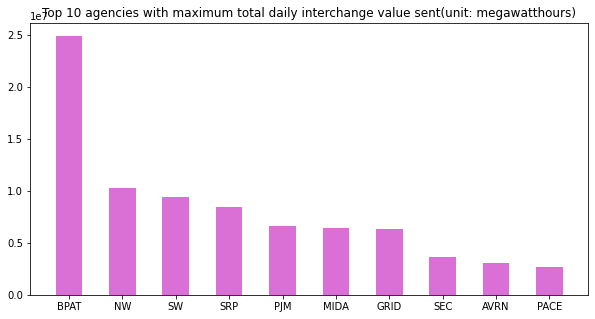

In [21]:
top10 = []
top10_value = []
for key in fromba:
    if len(top10) < 10:
        top10.append(key)
        top10_value.append(fromba[key])
plt.bar(top10, top10_value, width=0.5, color='orchid')
plt.title('Top 10 agencies with maximum total daily interchange value sent(unit: megawatthours)')
plt.show()

In [22]:
toba = dict(df['toba'].value_counts())
for key in toba:
    toba[key] = 0
for idx, row in df.iterrows():
    try:
        toba[row['toba']] += int(row['value'])
    except ValueError:
        continue
toba = dict(sorted(toba.items(), key=lambda item: item[1], reverse=True))
del toba['toba']

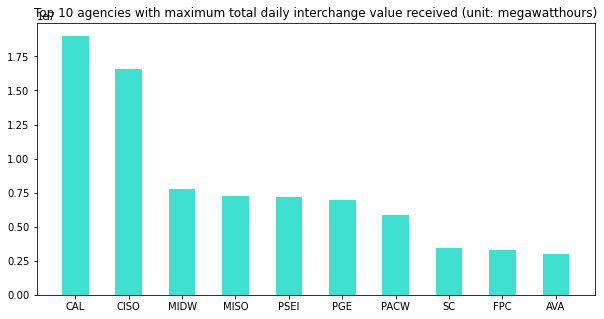

In [24]:
top10 = []
top10_value = []
for key in toba:
    if len(top10) < 10:
        top10.append(key)
        top10_value.append(toba[key])
plt.bar(top10, top10_value, width=0.5, color='turquoise')
plt.title('Top 10 agencies with maximum total daily interchange value received (unit: megawatthours)')
plt.show()

### Daily region sub ba data (07/17/22 - 11/17/22)

In [25]:
df = pd.read_csv('./data/data/rto/csv/daily-region-sub-ba-data_data.csv')

In [26]:
df.head(10)

,Unnamed: 0,period,subba,subba-name,parent,parent-name,timezone,value,value-units
0,0.0,2022-11-17,OKGE,Oklahoma Gas and Electric Co.,SWPP,Southwest Power Pool,Eastern,97310,megawatthours
1,1.0,2022-11-17,Frep,Freeport,PNM,Public Service Company of New Mexico,Arizona,1693,megawatthours
2,2.0,2022-11-17,GRDA,Grand River Dam Authority,SWPP,Southwest Power Pool,Eastern,19746,megawatthours
3,3.0,2022-11-17,TSGT,Tri-State Generation and Transmission,PNM,Public Service Company of New Mexico,Arizona,7463,megawatthours
4,4.0,2022-11-17,KAFB,Kirtland Air Force Base,PNM,Public Service Company of New Mexico,Eastern,1193,megawatthours
5,5.0,2022-11-17,OPPD,Omaha Public Power District,SWPP,Southwest Power Pool,Eastern,36311,megawatthours
6,6.0,2022-11-17,LES,Lincoln Electric System,SWPP,Southwest Power Pool,Central,10021,megawatthours
7,7.0,2022-11-17,INDN,Independence Power & Light,SWPP,Southwest Power Pool,Eastern,2839,megawatthours
8,8.0,2022-11-17,ZONJ,New York City,NYIS,New York Independent System Operator,Eastern,127120,megawatthours
9,9.0,2022-11-17,LAC,Los Alamos County,PNM,Public Service Company of New Mexico,Central,1861,megawatthours


In [27]:
df_timezone = pd.DataFrame(df['timezone'].value_counts())
df_timezone = df_timezone.drop(['timezone'])
sum1 = [0] * 5
for idx, row in df.iterrows():
    if row['timezone'] == 'Eastern':
        sum1[0] += int(row['value'])
    elif row['timezone'] == 'Central':
        sum1[1] += int(row['value'])
    elif row['timezone'] == 'Mountain':
        sum1[2] += int(row['value'])
    elif row['timezone'] == 'Arizona':
        sum1[3] += int(row['value'])
    elif row['timezone'] == 'Pacific':
        sum1[4] += int(row['value'])
df_timezone['total value'] = sum1

In [28]:
df_timezone

,timezone,total value
Eastern,10081,920165727
Central,10069,921358530
Mountain,9969,905687207
Arizona,9958,907894040
Pacific,9923,903641156


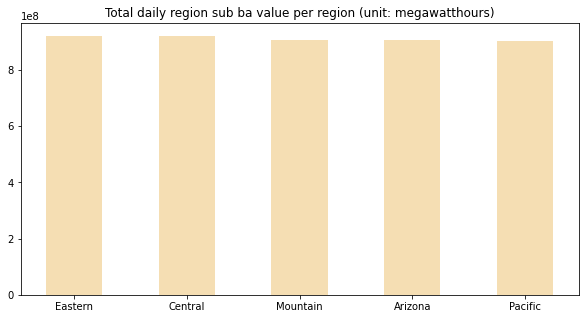

In [31]:
plt.bar(['Eastern', 'Central', 'Mountain', 'Arizona', 'Pacific'], df_timezone['total value'], width=0.5, color='wheat')
plt.title('Total daily region sub ba value per region (unit: megawatthours)')
plt.show()

In [32]:
subba = dict(df['subba'].value_counts())
for key in subba:
    subba[key] = 0
for idx, row in df.iterrows():
    try:
        subba[row['subba']] += int(row['value'])
    except ValueError:
        continue
subba = dict(sorted(subba.items(), key=lambda item: item[1], reverse=True))
del subba['subba']

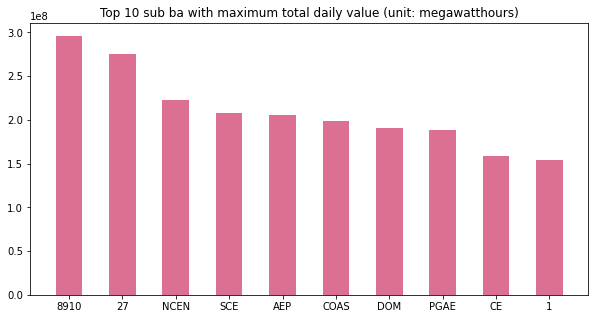

In [37]:
top10 = []
top10_value = []
for key in subba:
    if len(top10) < 10:
        top10.append(key)
        top10_value.append(subba[key])
plt.bar(top10, top10_value, width=0.5, color='palevioletred')
plt.title('Top 10 sub ba with maximum total daily value (unit: megawatthours)')
plt.show()

In [34]:
parent = dict(df['parent'].value_counts())
for key in parent:
    parent[key] = 0
for idx, row in df.iterrows():
    try:
        parent[row['parent']] += int(row['value'])
    except ValueError:
        continue
parent = dict(sorted(parent.items(), key=lambda item: item[1], reverse=True))
del parent['parent']

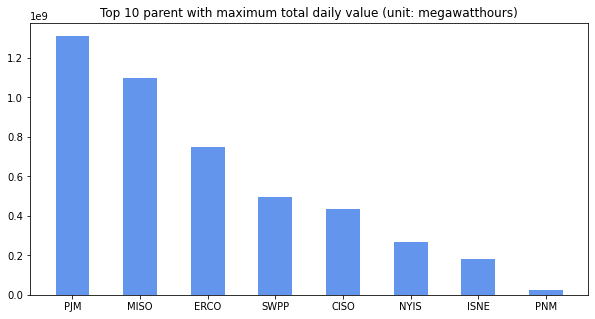

In [36]:
top10 = []
top10_value = []
for key in parent:
    if len(top10) < 10:
        top10.append(key)
        top10_value.append(parent[key])
plt.bar(top10, top10_value, width=0.5, color='cornflowerblue')
plt.title('Top 10 parent with maximum total daily value (unit: megawatthours)')
plt.show()

# <center> Forecasting </center>

## Section 1: Natural Gas Consumption Forecasting

### Load essential libraries

In [1]:
import eia
from collections import defaultdict
import pandas as pd
import plotly.express as px
from statsmodels.tsa.ar_model import AutoReg
import numpy as np
import plotly.graph_objects as go
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_pacf, plot_acf

### Load natural gas consumption by sector data set

In [2]:
df_nt = pd.read_csv("Natural_Gas_consumption_by_sector2.csv")

In [3]:
df_nt

,Sector,Residential,Commercial,Industrial,Electric Power,Lease and Plant Fuel,Pipeline and Distribution Use,Vehicle Use,Total Consumption,Other
0,Jan 2014,33.46,18.44,23.30,21.38,3.90,2.78,0.10,103.36,6.78
1,Feb 2014,30.46,17.50,23.54,19.68,3.99,2.62,0.10,97.90,6.71
2,Mar 2014,22.58,13.58,21.96,18.09,4.02,2.19,0.10,82.51,6.31
3,Apr 2014,11.87,8.37,20.93,18.30,4.12,1.71,0.10,65.39,5.93
4,May 2014,6.56,5.70,19.55,20.87,4.10,1.52,0.10,58.39,5.72
...,...,...,...,...,...,...,...,...,...,...
102,Jul 2022,3.59,4.70,21.64,45.17,5.48,3.09,0.15,83.80,8.72
103,Aug 2022,3.32,4.58,21.68,44.50,5.50,3.05,0.15,82.78,8.70
104,Sep 2022,4.03,5.33,21.53,37.17,5.56,2.81,0.15,76.59,8.52
105,Oct 2022,7.94,7.61,22.26,31.04,5.56,2.84,0.15,77.40,8.55


### Plot natural gas consumption by sector across periods

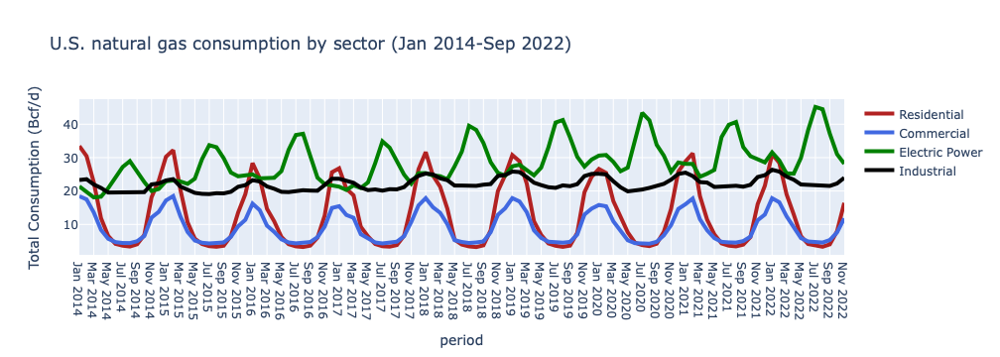

In [4]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=df_nt["Sector"], y=df_nt["Residential"], name="Residential",
                         line=dict(color='firebrick', width=4)))
fig.add_trace(go.Scatter(x=df_nt["Sector"], y=df_nt["Commercial"], name="Commercial",
                         line=dict(color='royalblue', width=4)))
fig.add_trace(go.Scatter(x=df_nt["Sector"], y=df_nt["Electric Power"], name="Electric Power",
                         line=dict(color='green', width=4)))
fig.add_trace(go.Scatter(x=df_nt["Sector"], y=df_nt["Industrial"], name="Industrial",
                         line=dict(color='black', width=4)))
fig.update_layout(title='U.S. natural gas consumption by sector (Jan 2014-Sep 2022)',
                   xaxis_title='period',
                   yaxis_title="Total Consumption (Bcf/d)")
fig.show()

In [5]:
fig.write_html("natural_gas_consumption_by_sector.html")

### Forecast natural gas consumtpion demand across sectors for the next year

### For forecasting, we have used AutoReg module from statsmodels package

### Statiscial analysis of our data set

In [6]:
dftest = adfuller(df_nt["Industrial"], autolag = 'AIC')

print(" 2 P-Value : ", dftest[1])

 2 P-Value :  0.6835890833910094


/Users/nehamittal/opt/anaconda3/lib/python3.9/site-packages/statsmodels/graphics/tsaplots.py:348: FutureWarning:

The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.



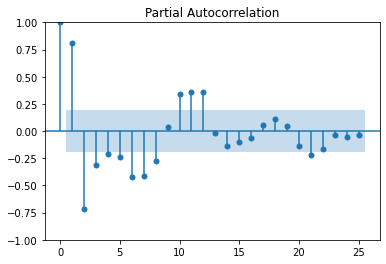

In [7]:
pacf=plot_pacf(df_nt["Residential"], lags=25)

### create dataframes for the sectors

In [8]:
X = df_nt["Residential"]
Y = df_nt["Commercial"]
Z = df_nt["Industrial"]
W = df_nt["Electric Power"]

### Split data set into train and test set

In [9]:
train_X = X[:len(X) - 8]
test_X = X[len(X) - 8:]
train_Y = Y[:len(Y) - 8]
test_Y = Y[len(Y) - 8:]
train_Z = Z[:len(Z) - 8]
test_Z = Z[len(Z) - 8:]
train_W = W[:len(W) - 8]
test_W = W[len(W) - 8:]

### Fit AutoReg model on the training sets

In [10]:
model_X = AutoReg(train_X, lags=25).fit()
model_Y = AutoReg(train_Y, lags=25).fit()
model_Z = AutoReg(train_Z, lags=25).fit()
model_W = AutoReg(train_W, lags=25).fit()

### Make prediction on the test set

In [11]:
pred_X = model_X.predict(start=len(train_X), end=len(X)-1, dynamic=False)
pred_Y = model_Y.predict(start=len(train_Y), end=len(Y)-1, dynamic=False)
pred_Z = model_Z.predict(start=len(train_Z), end=len(Z)-1, dynamic=False)
pred_W = model_W.predict(start=len(train_W), end=len(W)-1, dynamic=False)

### Plot corelation between actual and predicted values for Residential sector

99     12.778181
100     5.991392
101     3.100320
102     3.677694
103     2.974008
104     2.939226
105     6.623040
106    14.231207
dtype: float64


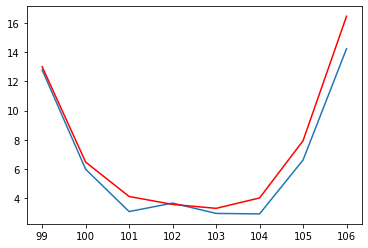

In [12]:
from matplotlib import pyplot
pyplot.plot(pred_X)
pyplot.plot(test_X, color='red')
print(pred_X)

### Report RMSE

In [13]:
from math import sqrt
from sklearn.metrics import mean_squared_error
rmse = sqrt(mean_squared_error(test_X, pred_X))

In [14]:
rmse

1.079513538992389

### Make predictions for the next year

In [15]:
pred_res_future = model_X.predict(start=len(X)-1, end=len(X) + 12, dynamic=False)
pred_com_future = model_Y.predict(start=len(Y)-1, end=len(Y) + 12, dynamic=False)
pred_ind_future = model_Z.predict(start=len(Z)-1, end=len(Z) + 12, dynamic=False)
pred_ele_future = model_W.predict(start=len(W)-1, end=len(W) + 12, dynamic=False)

### Initialize prediction columns with nan for the next year in our original data set

In [16]:
df_nt["res_pred"] = np.nan
df_nt["com_pred"] = np.nan
df_nt["ind_pred"] = np.nan
df_nt["ele_pred"] = np.nan

In [17]:
df_nt.head()

,Sector,Residential,Commercial,Industrial,Electric Power,Lease and Plant Fuel,Pipeline and Distribution Use,Vehicle Use,Total Consumption,Other,res_pred,com_pred,ind_pred,ele_pred
0,Jan 2014,33.46,18.44,23.30,21.38,3.90,2.78,0.1,103.36,6.78,NaN,NaN,NaN,NaN
1,Feb 2014,30.46,17.50,23.54,19.68,3.99,2.62,0.1,97.90,6.71,NaN,NaN,NaN,NaN
2,Mar 2014,22.58,13.58,21.96,18.09,4.02,2.19,0.1,82.51,6.31,NaN,NaN,NaN,NaN
3,Apr 2014,11.87,8.37,20.93,18.30,4.12,1.71,0.1,65.39,5.93,NaN,NaN,NaN,NaN
4,May 2014,6.56,5.70,19.55,20.87,4.10,1.52,0.1,58.39,5.72,NaN,NaN,NaN,NaN


In [18]:
df2_res_pred = pd.DataFrame({'Sector': ['Nov 2022', 'Dec 2022', 'Jan 2023', 'Feb 2023', 'Mar 2023', 'Apr 2023', 'May 2023', 'Jun 2023', 'Jul 2023', 'Aug 2023', 'Sep 2023', 'Oct 2023' ,'Nov 2023', 'Dec 2023'], 
                            'res_pred': pred_res_future,
                            'com_pred': pred_com_future,
                            'ind_pred': pred_ind_future,
                            'ele_pred': pred_ele_future})

In [19]:
df2_res_pred.head()

,Sector,res_pred,com_pred,ind_pred,ele_pred
106,Nov 2022,14.231207,9.833376,24.129826,29.727759
107,Dec 2022,24.607326,14.762480,26.051841,30.480435
108,Jan 2023,29.761716,17.177333,26.750192,31.097524
109,Feb 2023,27.131297,16.205380,26.015824,29.592489
110,Mar 2023,19.833840,12.539459,24.312438,24.914065


### Concatenate predictions to our original dataframe

In [20]:
df3 = pd.concat([df_nt, df2_res_pred], ignore_index=True)

In [21]:
df3

,Sector,Residential,Commercial,Industrial,Electric Power,Lease and Plant Fuel,Pipeline and Distribution Use,Vehicle Use,Total Consumption,Other,res_pred,com_pred,ind_pred,ele_pred
0,Jan 2014,33.46,18.44,23.30,21.38,3.90,2.78,0.1,103.36,6.78,NaN,NaN,NaN,NaN
1,Feb 2014,30.46,17.50,23.54,19.68,3.99,2.62,0.1,97.90,6.71,NaN,NaN,NaN,NaN
2,Mar 2014,22.58,13.58,21.96,18.09,4.02,2.19,0.1,82.51,6.31,NaN,NaN,NaN,NaN
3,Apr 2014,11.87,8.37,20.93,18.30,4.12,1.71,0.1,65.39,5.93,NaN,NaN,NaN,NaN
4,May 2014,6.56,5.70,19.55,20.87,4.10,1.52,0.1,58.39,5.72,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116,Aug 2023,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.503326,4.130741,20.400352,41.142528
117,Sep 2023,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.051593,4.661154,20.900988,34.991508
118,Oct 2023,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.698139,6.338357,22.392623,30.749663
119,Nov 2023,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14.929176,10.031411,24.450642,29.507892


### Plot forecasted natural gas consumption by sector across periods

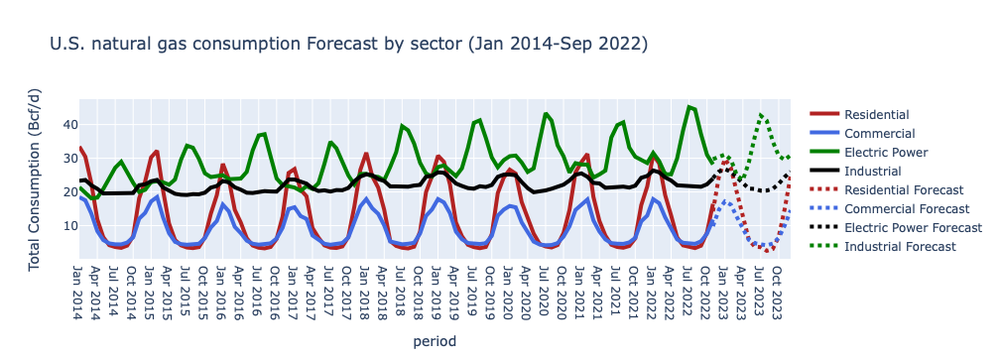

In [22]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=df3["Sector"], y=df3["Residential"], name="Residential",
                         line=dict(color='firebrick', width=4)))
fig.add_trace(go.Scatter(x=df3["Sector"], y=df3["Commercial"], name="Commercial",
                         line=dict(color='royalblue', width=4)))
fig.add_trace(go.Scatter(x=df3["Sector"], y=df3["Electric Power"], name="Electric Power",
                         line=dict(color='green', width=4)))
fig.add_trace(go.Scatter(x=df3["Sector"], y=df3["Industrial"], name="Industrial",
                         line=dict(color='black', width=4)))
fig.add_trace(go.Scatter(x=df3["Sector"], y=df3["res_pred"],name="Residential Forecast",
                         line=dict(color='firebrick', width=4, dash='dot')))
fig.add_trace(go.Scatter(x=df3["Sector"], y=df3["com_pred"], name="Commercial Forecast",
                         line=dict(color='royalblue', width=4, dash='dot')))
fig.add_trace(go.Scatter(x=df3["Sector"], y=df3["ind_pred"], name="Electric Power Forecast",
                         line=dict(color='black', width=4, dash='dot')))
fig.add_trace(go.Scatter(x=df3["Sector"], y=df3["ele_pred"],name="Industrial Forecast",
                         line=dict(color='green', width=4, dash='dot')))
fig.update_layout(title='U.S. natural gas consumption Forecast by sector (Jan 2014-Sep 2022)',
                   xaxis_title='period',
                   yaxis_title="Total Consumption (Bcf/d)")
fig.show()

### Save plot in an html file

In [23]:
fig.write_html("natural_gas_consumption_forecast_by_sector.html")

## Section 2: Electricity Demand Forecasting

This section has the forecasting model for predicting the electricity demand. The rto-region-data is used for this. We use Prophet model for this purpose. You can know more about prophet here: https://facebook.github.io/prophet/

### Importing necessary libraries

In [1]:
import eia
import pandas as pd 
import plotly.express as px
import prophet
from sklearn.metrics import mean_absolute_error
import matplotlib

### Loading RTO Data

In [2]:
region_data=eia.loaders.load_dataframe(data="rto-region-data")

In [3]:
region_data[region_data["type"]=="D"].groupby(['period']).sum()

,Unnamed: 0
period,
2022-11-04T06,316642.0
2022-11-04T07,298485.0
2022-11-04T08,283410.0
2022-11-04T09,264248.0
2022-11-04T10,245086.0
...,...
2022-11-11T21,61506.0
2022-11-11T22,52595.0
2022-11-11T23,43684.0


In [4]:
#Convert data type
region_data=region_data[region_data["type"]=="D"].astype({'value':'float'})

In [5]:
#Aggregating Demand for each timestamp
df=region_data[region_data["type"]=="D"].groupby(['period']).sum()

In [6]:
#Converting the dataframe to a format prophet model understands
df1=pd.DataFrame()
df1["y"]=df["value"]
df1["ds"]=df.index

In [7]:
df1

,y,ds
period,,
2022-11-04T06,1129524.0,2022-11-04T06
2022-11-04T07,1097349.0,2022-11-04T07
2022-11-04T08,1077567.0,2022-11-04T08
2022-11-04T09,1076958.0,2022-11-04T09
2022-11-04T10,1101372.0,2022-11-04T10
...,...,...
2022-11-11T21,1362642.0,2022-11-11T21
2022-11-11T22,1358040.0,2022-11-11T22
2022-11-11T23,1371486.0,2022-11-11T23


<AxesSubplot:xlabel='period'>

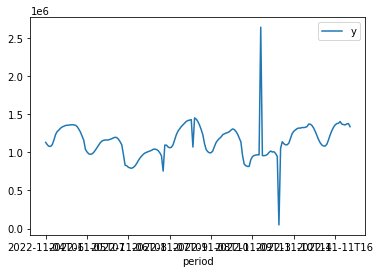

In [8]:
#Visualising the timeseries data
df1.plot()

In [9]:
# Renaming the dataframe to a format prophet model understands
df1=df1.rename(columns={"value":"y"},index={"period":"ds"})

In [10]:
df1.index.names=["index"]

In [11]:
df1=df1.reset_index(drop=True)

### Train Test Split

In [12]:
df1_train,df1_test=df1[:int(0.8*len(df1))], df1[int(0.8*len(df1)):]

In [13]:
df1_test["ds"]

148    2022-11-10T12
149    2022-11-10T13
150    2022-11-10T14
151    2022-11-10T15
152    2022-11-10T16
153    2022-11-10T17
154    2022-11-10T18
155    2022-11-10T19
156    2022-11-10T20
157    2022-11-10T21
158    2022-11-10T22
159    2022-11-11T00
160    2022-11-11T01
161    2022-11-11T02
162    2022-11-11T03
163    2022-11-11T04
164    2022-11-11T05
165    2022-11-11T06
166    2022-11-11T07
167    2022-11-11T08
168    2022-11-11T09
169    2022-11-11T10
170    2022-11-11T11
171    2022-11-11T12
172    2022-11-11T13
173    2022-11-11T14
174    2022-11-11T15
175    2022-11-11T16
176    2022-11-11T17
177    2022-11-11T18
178    2022-11-11T19
179    2022-11-11T20
180    2022-11-11T21
181    2022-11-11T22
182    2022-11-11T23
183    2022-11-12T00
184    2022-11-12T01
Name: ds, dtype: object

### Train the model

In [14]:
model = prophet.Prophet()
model.fit(df1_train)

19:33:05 - cmdstanpy - INFO - Chain [1] start processing
19:33:05 - cmdstanpy - INFO - Chain [1] done processing


In [15]:
model.history

,y,ds,floor,t,y_scaled
0,1129524.0,2022-11-04 06:00:00,0,0.000000,0.428235
1,1097349.0,2022-11-04 07:00:00,0,0.006711,0.416036
2,1077567.0,2022-11-04 08:00:00,0,0.013423,0.408536
3,1076958.0,2022-11-04 09:00:00,0,0.020134,0.408305
4,1101372.0,2022-11-04 10:00:00,0,0.026846,0.417561
...,...,...,...,...,...
143,1137828.0,2022-11-10 07:00:00,0,0.973154,0.431383
144,1111863.0,2022-11-10 08:00:00,0,0.979866,0.421539
145,1097157.0,2022-11-10 09:00:00,0,0.986577,0.415963
146,1098765.0,2022-11-10 10:00:00,0,0.993289,0.416573


### Perform Prediction

In [16]:
preds=model.predict(df1_test)

In [17]:
preds

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,daily_lower,daily_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2022-11-10 12:00:00,1.084869e+06,7.547033e+05,1.259218e+06,1.084869e+06,1.084869e+06,-77416.632034,-77416.632034,-77416.632034,-77416.632034,-77416.632034,-77416.632034,0.0,0.0,0.0,1.007452e+06
1,2022-11-10 13:00:00,1.084571e+06,7.628501e+05,1.281542e+06,1.084551e+06,1.084588e+06,-50708.195610,-50708.195610,-50708.195610,-50708.195610,-50708.195610,-50708.195610,0.0,0.0,0.0,1.033863e+06
2,2022-11-10 14:00:00,1.084273e+06,8.027009e+05,1.313878e+06,1.084206e+06,1.084318e+06,-27730.386001,-27730.386001,-27730.386001,-27730.386001,-27730.386001,-27730.386001,0.0,0.0,0.0,1.056543e+06
3,2022-11-10 15:00:00,1.083975e+06,8.361824e+05,1.345869e+06,1.083833e+06,1.084077e+06,5128.209139,5128.209139,5128.209139,5128.209139,5128.209139,5128.209139,0.0,0.0,0.0,1.089103e+06
4,2022-11-10 16:00:00,1.083677e+06,8.905925e+05,1.398298e+06,1.083456e+06,1.083853e+06,58145.300060,58145.300060,58145.300060,58145.300060,58145.300060,58145.300060,0.0,0.0,0.0,1.141822e+06
5,2022-11-10 17:00:00,1.083379e+06,9.464717e+05,1.448678e+06,1.083077e+06,1.083645e+06,120698.577706,120698.577706,120698.577706,120698.577706,120698.577706,120698.577706,0.0,0.0,0.0,1.204078e+06
6,2022-11-10 18:00:00,1.083081e+06,1.002206e+06,1.494781e+06,1.082693e+06,1.083424e+06,162838.172667,162838.172667,162838.172667,162838.172667,162838.172667,162838.172667,0.0,0.0,0.0,1.245919e+06
7,2022-11-10 19:00:00,1.082783e+06,9.834110e+05,1.497769e+06,1.082300e+06,1.083236e+06,158808.587814,158808.587814,158808.587814,158808.587814,158808.587814,158808.587814,0.0,0.0,0.0,1.241592e+06
8,2022-11-10 20:00:00,1.082485e+06,9.397394e+05,1.451508e+06,1.081884e+06,1.083047e+06,112346.797177,112346.797177,112346.797177,112346.797177,112346.797177,112346.797177,0.0,0.0,0.0,1.194832e+06
9,2022-11-10 21:00:00,1.082187e+06,8.701280e+05,1.387479e+06,1.081461e+06,1.082865e+06,58719.632355,58719.632355,58719.632355,58719.632355,58719.632355,58719.632355,0.0,0.0,0.0,1.140907e+06


In [18]:
df1_test=df1_test.reset_index(drop=True)

### Plot and compare the prediction and true value

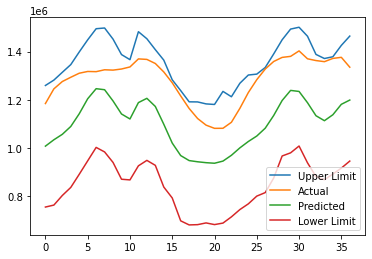

In [19]:
matplotlib.pyplot.plot(preds['yhat_upper'], label='Upper Limit')
matplotlib.pyplot.plot(df1_test['y'], label='Actual')
matplotlib.pyplot.plot(preds['yhat'], label='Predicted')
matplotlib.pyplot.plot(preds['yhat_lower'], label='Lower Limit')
matplotlib.pyplot.legend()
matplotlib.pyplot.show()